In [470]:
import numpy as np
import pandas as pd
import seaborn as sns
from sklearn.metrics import accuracy_score,davies_bouldin_score, silhouette_score, silhouette_samples, adjusted_mutual_info_score, v_measure_score, adjusted_rand_score, fowlkes_mallows_score, homogeneity_score, completeness_score
from sklearn.metrics import fbeta_score, make_scorer, confusion_matrix, ConfusionMatrixDisplay, recall_score, precision_score, r2_score, mean_squared_error
from sklearn.model_selection import GridSearchCV, TimeSeriesSplit, train_test_split, cross_val_score, cross_validate, RandomizedSearchCV
from imblearn.over_sampling import SMOTE
from sklearn.preprocessing import MinMaxScaler
import matplotlib.pyplot as plt
from statsmodels.tsa.stattools import adfuller
from sklearn.utils.class_weight import compute_class_weight
from sklearn.neural_network import MLPClassifier
from sklearn import neural_network
import random
from sklearn.cluster import KMeans
from sklearn import metrics
from sklearn.decomposition import PCA, FastICA
import matplotlib.cm as cm
from scipy.stats import kurtosis
from sklearn.feature_selection import mutual_info_regression

In [311]:
RAW_DATA = pd.read_excel('BOTH.xlsx',sheet_name='FX_SPOT');

In [4]:
RAW_DATA['Date'] = pd.to_datetime(RAW_DATA['Date'], format='%Y-%m-%d')

RAW_DATA[RAW_DATA.Date < '2011-01-01'];

In [5]:
RAW_DATA.head(2)

,Date,FIVEday_Return,EURUSD,EMAVG (22),EMAVG(5),ROC (5),ROC (10),Z-Score(260),Z-Score(130),Z-Score(65),...,%B,"MLR(10,0,0)",MLRUB(1),MLRLB(1),VE_Upper Band,VE_Lower Band,'+DMI(10),'-DMI,ADX,"RMI(Close,21,10)"
0,2007-01-01,-0.013499,1.3201,1.3141,1.3170,0.6097,0.7864,1.6714,1.7791,1.1182,...,0.5056,1.3163,1.3205,1.3122,1.3245,1.3024,58.1824,41.8176,17.5080,67.0857
1,2007-01-02,-0.020783,1.3273,1.3152,1.3204,1.3438,0.5759,1.8452,2.0683,1.3455,...,0.7552,1.3193,1.3243,1.3143,1.3229,1.3010,65.9698,34.0302,18.9512,67.8361


In [6]:
#Visualize Dataset Stats
Dataset_Stats = RAW_DATA.describe()
Dataset_Stats.loc['skew'] = RAW_DATA.skew()
Dataset_Stats.loc['kurtosis'] = RAW_DATA.kurtosis()
Dataset_Stats.transpose()

,count,mean,std,min,25%,50%,75%,max,skew,kurtosis
FIVEday_Return,3887.0,-0.000198,0.012795,-0.06704,-0.007459,0.0000,0.007368,0.101899,0.006113,2.956586
EURUSD,3887.0,1.259026,0.129950,1.03880,1.135450,1.2554,1.358300,1.599100,0.339729,-0.814161
EMAVG (22),3887.0,1.259482,0.128658,1.05090,1.135150,1.2629,1.357650,1.577800,0.317722,-0.850864
EMAVG(5),3887.0,1.259122,0.129671,1.04380,1.135300,1.2559,1.357500,1.591000,0.335930,-0.822651
ROC (5),3887.0,-0.011261,1.279674,-6.48420,-0.742950,0.0000,0.739550,10.727200,0.102429,3.199956
ROC (10),3887.0,-0.021275,1.813736,-8.63000,-1.043100,-0.0177,1.032500,13.391500,0.139126,3.056106
Z-Score(260),3887.0,-0.003152,1.463318,-3.87430,-1.155600,0.0197,1.267300,4.169400,-0.088233,-0.919470
Z-Score(130),3887.0,-0.017328,1.436455,-3.59220,-1.209650,0.0226,1.137150,3.907700,-0.088414,-0.931553
Z-Score(65),3887.0,-0.012820,1.388361,-4.08650,-1.124900,0.0334,1.106950,3.473400,-0.105660,-0.820626
RSI (22),3887.0,49.870365,9.768931,20.18240,43.450300,50.0583,56.563950,77.268700,-0.126166,-0.254859


In [7]:
#ADF Test fro Stationarity
def adfuller_test(series, signif=0.10):
    """
    Perform Augmented Dickey-Fuller to test for Stationarity of the given series
    and print report. Null Hypothesis: Data has unit root and is non-stationary.

    series: time series in pd.Series format
    signif: significance level for P-value to reject Null Hypothesis
    """
    x = adfuller(series, autolag='AIC')

    #using dictionary saves different data types (float, int, boolean)
    output = {'Test Statistic': x[0], 
              'P-value': x[1], 
              'Number of lags': x[2], 
              'Number of observations': x[3],
              f'Reject (signif. level {signif})': x[1] < signif }

    for key, val in x[4].items():
         output[f'Critical value {key}'] = val

    return pd.Series(output)

In [8]:
ADF_TEST = RAW_DATA.apply(lambda x: adfuller_test(x), axis=0)

In [9]:
NON_STATIONARY_FEATURES = ADF_TEST.loc[['Reject (signif. level 0.1)','Test Statistic','Critical value 10%']].transpose()
NON_STATIONARY_FEATURES = NON_STATIONARY_FEATURES[NON_STATIONARY_FEATURES['Reject (signif. level 0.1)']==0]
NON_STATIONARY_FEATURES

,Reject (signif. level 0.1),Test Statistic,Critical value 10%
Date,False,21.7338,-2.56717
EURUSD,False,-1.64127,-2.56717
EMAVG (22),False,-1.72009,-2.56717
EMAVG(5),False,-1.68032,-2.56717
UBB(2),False,-1.64086,-2.56717
BollMA (22),False,-2.0657,-2.56717
LBB(2),False,-1.82334,-2.56717
"MLR(10,0,0)",False,-1.69774,-2.56717
MLRUB(1),False,-1.6654,-2.56717
MLRLB(1),False,-1.72592,-2.56717


In [10]:
#So you should differentiate (aka 5 day change) these features and then Normalize ALL features
for idx in range(1,len(NON_STATIONARY_FEATURES.index)):
    RAW_DATA[NON_STATIONARY_FEATURES.index[idx]] = RAW_DATA[NON_STATIONARY_FEATURES.index[idx]].diff(5)
RAW_DATA.dropna(inplace=True)
RAW_DATA.head(7)

,Date,FIVEday_Return,EURUSD,EMAVG (22),EMAVG(5),ROC (5),ROC (10),Z-Score(260),Z-Score(130),Z-Score(65),...,%B,"MLR(10,0,0)",MLRUB(1),MLRLB(1),VE_Upper Band,VE_Lower Band,'+DMI(10),'-DMI,ADX,"RMI(Close,21,10)"
5,2007-01-08,-0.006625,-0.0177,-0.0016,-0.0092,-1.3408,-0.7393,1.1457,0.8479,0.3201,...,0.0468,-0.0071,-0.0034,-0.0109,-0.0092,-0.0085,38.3185,61.6815,18.7996,61.0692
6,2007-01-09,-0.006328,-0.0273,-0.0038,-0.0152,-2.0568,-0.7406,1.0743,0.7287,0.2039,...,0.0333,-0.0144,-0.0115,-0.0174,-0.0093,-0.0085,36.3564,63.6436,19.6483,59.0936
7,2007-01-10,0.000000,-0.0231,-0.0055,-0.0178,-1.7541,-1.3421,0.9031,0.4371,-0.0668,...,-0.0633,-0.0213,-0.0186,-0.0239,-0.0088,-0.0079,31.6978,68.3022,21.3439,55.6630
8,2007-01-11,0.005415,-0.0191,-0.0067,-0.0182,-1.4598,-1.9544,0.7775,0.2243,-0.2741,...,-0.0975,-0.0254,-0.0251,-0.0258,-0.0077,-0.0065,28.7289,71.2711,23.4638,51.1134
9,2007-01-12,0.002628,-0.0079,-0.0068,-0.0148,-0.6076,-2.0762,0.8506,0.3532,-0.1817,...,0.0461,-0.0249,-0.0277,-0.0222,-0.0070,-0.0058,33.3528,66.6472,24.4468,46.8286
10,2007-01-15,0.001004,-0.0086,-0.0069,-0.0127,-0.6603,-1.9923,0.8836,0.4107,-0.1486,...,0.1281,-0.0226,-0.0253,-0.0199,-0.0066,-0.0051,35.6714,64.3286,24.8679,43.1805
11,2007-01-16,0.008326,-0.0082,-0.0070,-0.0112,-0.6308,-2.6746,0.8237,0.3062,-0.2671,...,0.1199,-0.0193,-0.0214,-0.0170,-0.0051,-0.0038,33.9230,66.0770,25.5965,38.8868


In [11]:
#Check stationarity condition again
ADF_TEST = RAW_DATA.apply(lambda x: adfuller_test(x), axis=0)

In [12]:
NON_STATIONARY_FEATURES = ADF_TEST.loc[['Reject (signif. level 0.1)','Test Statistic','Critical value 10%']].transpose()
NON_STATIONARY_FEATURES = NON_STATIONARY_FEATURES[NON_STATIONARY_FEATURES['Reject (signif. level 0.1)']==0]
NON_STATIONARY_FEATURES

,Reject (signif. level 0.1),Test Statistic,Critical value 10%


In [13]:
ADF_TEST.loc[['Reject (signif. level 0.1)','Test Statistic','Critical value 10%']].transpose()

,Reject (signif. level 0.1),Test Statistic,Critical value 10%
Date,True,-11.5953,-2.56717
FIVEday_Return,True,-9.95385,-2.56717
EURUSD,True,-9.92943,-2.56717
EMAVG (22),True,-7.42394,-2.56717
EMAVG(5),True,-9.09344,-2.56717
ROC (5),True,-9.96228,-2.56717
ROC (10),True,-8.69187,-2.56717
Z-Score(260),True,-3.60642,-2.56717
Z-Score(130),True,-6.01307,-2.56717
Z-Score(65),True,-8.51626,-2.56717


In [14]:
#Since EURUSD variable is nonstationary we delete it 
del RAW_DATA['EURUSD']

In [15]:
#RUN in laptop (histogram scatter)
#sns.pairplot(RAW_DATA.iloc[:,2:-5])

In [16]:
#Create binary variable based on the PnL of the trade
RAW_DATA['FIVEday_Return'] =  np.where(RAW_DATA['FIVEday_Return']>0, 1, 0)

In [17]:
#Split data into train and test 70/30
x = RAW_DATA.iloc[:,2:]   # Third column until the last column
y = RAW_DATA.iloc[:,1]    # Second column (PnL Positive) is our target
# Always keep shuffle = False for financial time series
x_train, x_test, y_train, y_test = train_test_split(x, y, test_size=.3, shuffle =False)

In [18]:
#Check if data is imbalanced
sum(y_train == 1) / sum(y_train == 0)
#WE HAVE A BALANCED DATASET

0.9919354838709677

In [19]:
#Normalizing my data
#Fit scaler on training data
norm = MinMaxScaler().fit(x_train)

# transform training data
x_train_norm = norm.transform(x_train)

# transform testing dataabs
x_test_norm = norm.transform(x_test)

In [20]:
x_train_norm.shape

(2717, 28)

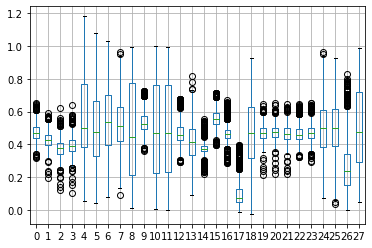

In [21]:
pd.DataFrame(x_test_norm).boxplot()

In [22]:
x_train_norm.shape

(2717, 28)

In [23]:
Feature_Names = RAW_DATA.columns[2:]
len(Feature_Names)

28

# K MEANS

In [383]:
from sklearn.cluster import KMeans
from sklearn.preprocessing import MinMaxScaler
import plotly.graph_objects as go
import numpy as np

X=x_train_norm
scaler = MinMaxScaler()
scaler.fit(X)
X=scaler.transform(X)


inertia = []
sse, db, slc = {}, {}, {}

for k in range(2,11):
    kmeans = KMeans(
        n_clusters=k, init="k-means++",
        n_init=10,
        tol=1e-04, random_state=42
    )
    
    
    
    FIT = kmeans.fit(X)
    inertia.append(kmeans.inertia_)
    clusters = FIT.labels_
    sse[k] = FIT.inertia_
    db[k] = davies_bouldin_score(X, clusters)
    slc[k] = silhouette_score(X, clusters)

### Elbow Method

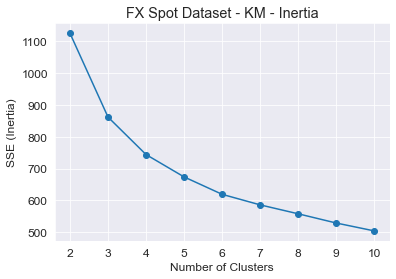

In [384]:
sns.set_style("darkgrid")
font = {'size'   : 12}
plt.rc('font', **font)
plt.plot(list(sse.keys()), list(sse.values()), marker='o')
plt.xlabel('Number of Clusters')
plt.ylabel('SSE (Inertia)')
plt.title('FX Spot Dataset - KM - Inertia')
plt.show()

In [26]:
# 4 Seems to be the best k value according to Elbow method

### Silhouette Analysis

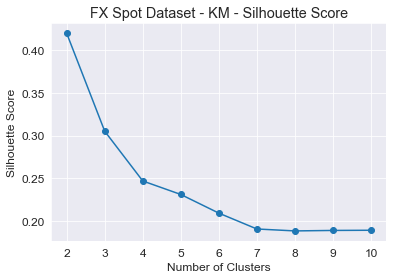

In [385]:
plt.plot(list(slc.keys()), list(slc.values()), marker='o')
plt.xlabel('Number of Clusters')
plt.ylabel('Silhouette Score')
plt.title('FX Spot Dataset - KM - Silhouette Score')

plt.show()

In [28]:
#For Sillhouette Score the higher the better. It seems like 2 is the best k accoring to sillhouette

### Davies-Bouldin Index

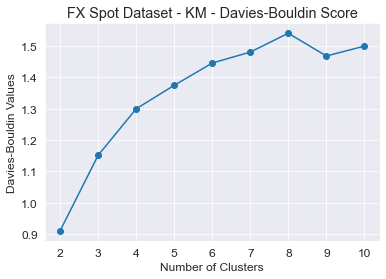

In [386]:
plt.plot(list(db.keys()), list(db.values()), marker='o')
plt.xlabel('Number of Clusters')
plt.ylabel('Davies-Bouldin Values')
plt.title('FX Spot Dataset - KM - Davies-Bouldin Score')
plt.show()

In [30]:
# For DB Index the lower the better so k=2 seems to be the best value here.

### Sillhouette Diagram

For n_clusters = 2 The average silhouette_score is : 0.4199437741876523
For n_clusters = 3 The average silhouette_score is : 0.30509879893107195
For n_clusters = 4 The average silhouette_score is : 0.24686821795444847
For n_clusters = 5 The average silhouette_score is : 0.22980128368409605


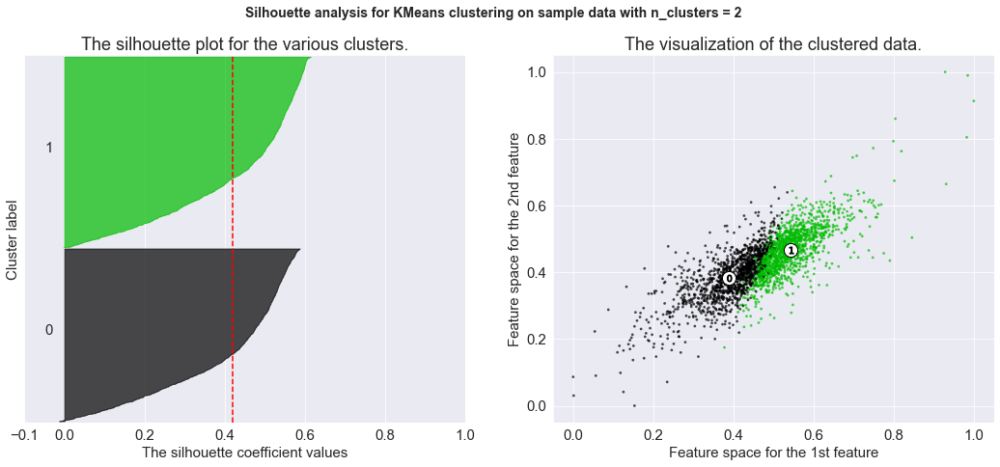

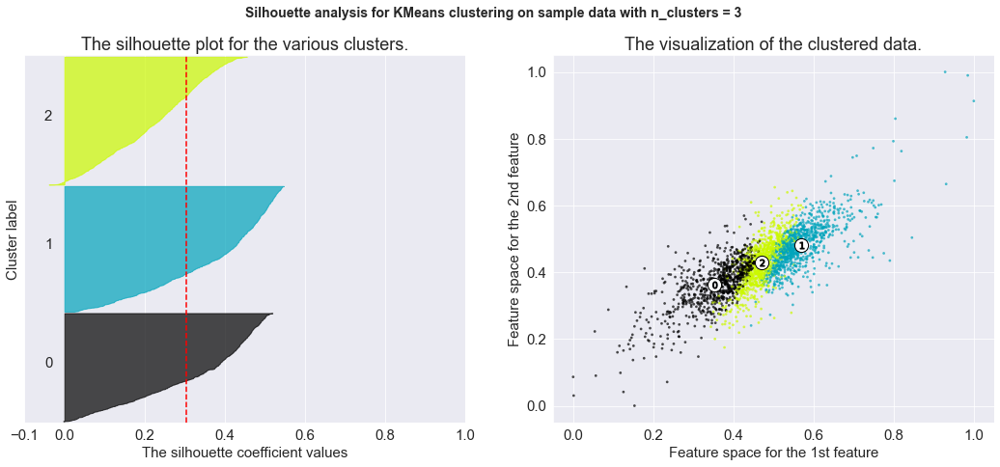

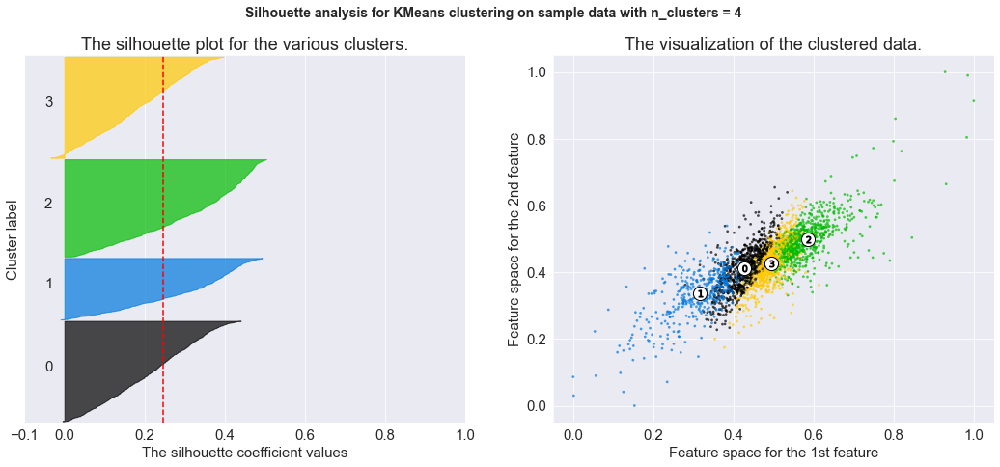

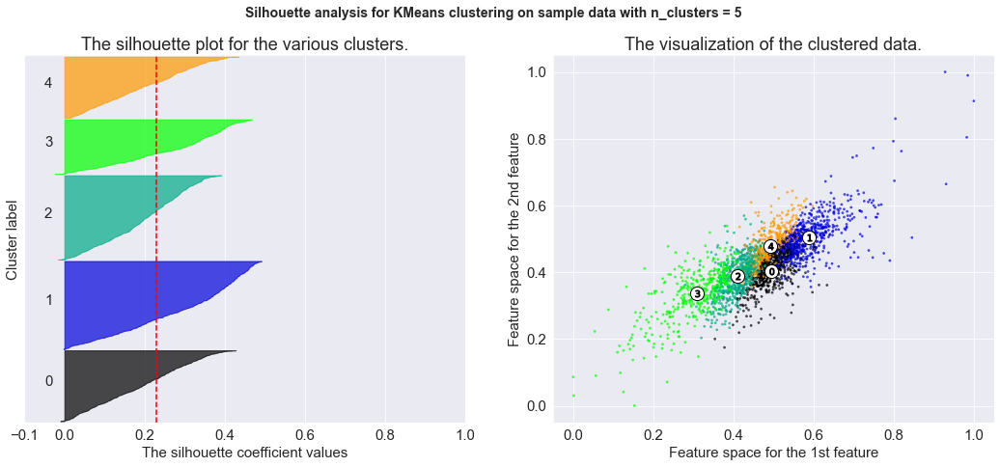

In [31]:
range_n_clusters = [2, 3, 4, 5]

for n_clusters in range_n_clusters:
    # Create a subplot with 1 row and 2 columns
    fig, (ax1, ax2) = plt.subplots(1, 2)
    fig.set_size_inches(18, 7)

    # The 1st subplot is the silhouette plot
    # The silhouette coefficient can range from -1, 1 but in this example all
    # lie within [-0.1, 1]
    ax1.set_xlim([-0.1, 1])
    # The (n_clusters+1)*10 is for inserting blank space between silhouette
    # plots of individual clusters, to demarcate them clearly.
    ax1.set_ylim([0, len(X) + (n_clusters + 1) * 10])

    # Initialize the clusterer with n_clusters value and a random generator
    # seed of 10 for reproducibility.
    clusterer = KMeans(n_clusters=n_clusters, random_state=10)
    cluster_labels = clusterer.fit_predict(X)

    # The silhouette_score gives the average value for all the samples.
    # This gives a perspective into the density and separation of the formed
    # clusters
    silhouette_avg = silhouette_score(X, cluster_labels)
    print(
        "For n_clusters =",
        n_clusters,
        "The average silhouette_score is :",
        silhouette_avg,
    )

    # Compute the silhouette scores for each sample
    sample_silhouette_values = silhouette_samples(X, cluster_labels)

    y_lower = 10
    for i in range(n_clusters):
        # Aggregate the silhouette scores for samples belonging to
        # cluster i, and sort them
        ith_cluster_silhouette_values = sample_silhouette_values[cluster_labels == i]

        ith_cluster_silhouette_values.sort()

        size_cluster_i = ith_cluster_silhouette_values.shape[0]
        y_upper = y_lower + size_cluster_i

        color = cm.nipy_spectral(float(i) / n_clusters)
        ax1.fill_betweenx(
            np.arange(y_lower, y_upper),
            0,
            ith_cluster_silhouette_values,
            facecolor=color,
            edgecolor=color,
            alpha=0.7,
        )

        # Label the silhouette plots with their cluster numbers at the middle
        ax1.text(-0.05, y_lower + 0.5 * size_cluster_i, str(i))

        # Compute the new y_lower for next plot
        y_lower = y_upper + 10  # 10 for the 0 samples

    ax1.set_title("The silhouette plot for the various clusters.")
    ax1.set_xlabel("The silhouette coefficient values")
    ax1.set_ylabel("Cluster label")

    # The vertical line for average silhouette score of all the values
    ax1.axvline(x=silhouette_avg, color="red", linestyle="--")

    ax1.set_yticks([])  # Clear the yaxis labels / ticks
    ax1.set_xticks([-0.1, 0, 0.2, 0.4, 0.6, 0.8, 1])

    # 2nd Plot showing the actual clusters formed
    colors = cm.nipy_spectral(cluster_labels.astype(float) / n_clusters)
    ax2.scatter(
        X[:, 0], X[:, 1], marker=".", s=30, lw=0, alpha=0.7, c=colors, edgecolor="k"
    )

    # Labeling the clusters
    centers = clusterer.cluster_centers_
    # Draw white circles at cluster centers
    ax2.scatter(
        centers[:, 0],
        centers[:, 1],
        marker="o",
        c="white",
        alpha=1,
        s=200,
        edgecolor="k",
    )

    for i, c in enumerate(centers):
        ax2.scatter(c[0], c[1], marker="$%d$" % i, alpha=1, s=50, edgecolor="k")

    ax2.set_title("The visualization of the clustered data.")
    ax2.set_xlabel("Feature space for the 1st feature")
    ax2.set_ylabel("Feature space for the 2nd feature")

    plt.suptitle(
        "Silhouette analysis for KMeans clustering on sample data with n_clusters = %d"
        % n_clusters,
        fontsize=14,
        fontweight="bold",
    )

plt.show()

Another informative graph we can create to determine the optimal value of K is the Silhouette Diagram. It plots silhouette coefficients for all the points in different clusters. The diagram includes a knife shape for each cluster. The width represents the silhouette coefficient for each point. The height represents the number of points in a given cluster. We can pick the optimal K with the following criteria: \

The Average Silhouette Index is high.\
The clusters are roughly balanced, i.e., Clusters have roughly the same number of points.\
Most of the points have higher Silhouette coefficients than the Average Silhouette Index.

In [32]:
#It seems like a value of 2 is optimal here according to sillhouette plots

### Compare predicted labels vs ground truth labels

In [276]:
#Create a DF of x train normalized values and the corresponding column names
X_TRAIN_NORM_DF = pd.DataFrame(x_train_norm, columns= list(x.columns))

In [285]:
#Print out diagonal labels based on K= optimal k
kmeans = KMeans(n_clusters = 2, n_init = 10, init = 'k-means++', random_state=123).fit(X)
clusters_KM = kmeans.labels_
X_TRAIN_NORM_DF['K-Means Predicted'] = clusters
#sns.pairplot(X_TRAIN_NORM_DF, hue="K-Means Predicted", diag_kind= 'kde')

In [279]:
X_TRAIN_NORM_DF.head()

,EMAVG (22),EMAVG(5),ROC (5),ROC (10),Z-Score(260),Z-Score(130),Z-Score(65),RSI (22),Spearman Indicator(22),"MACD(11,22)",...,"MLR(10,0,0)",MLRUB(1),MLRLB(1),VE_Upper Band,VE_Lower Band,'+DMI(10),'-DMI,ADX,"RMI(Close,21,10)",K-Means Predicted
0,0.454203,0.373479,0.298837,0.358318,0.737011,0.637790,0.602151,0.481205,0.263893,0.521407,...,0.436526,0.458545,0.416856,0.370370,0.378981,0.353725,0.646275,0.224612,0.624238,1
1,0.426600,0.336983,0.257236,0.358259,0.726528,0.620667,0.586272,0.460778,0.249644,0.507645,...,0.404009,0.424281,0.387244,0.369369,0.378981,0.329138,0.670862,0.241295,0.603825,1
2,0.405270,0.321168,0.274824,0.330945,0.701393,0.578781,0.549282,0.410200,0.238815,0.490826,...,0.373274,0.394247,0.357631,0.374374,0.385350,0.270763,0.729237,0.274627,0.568379,1
3,0.390213,0.318735,0.291923,0.303140,0.682953,0.548214,0.520955,0.375756,0.237674,0.472477,...,0.355011,0.366751,0.348975,0.385385,0.400212,0.233560,0.766440,0.316300,0.521371,1
4,0.388959,0.339416,0.341436,0.297609,0.693685,0.566729,0.533581,0.406977,0.229125,0.463303,...,0.357238,0.355753,0.365376,0.392392,0.407643,0.291501,0.708499,0.335624,0.477098,1


0.48535500690078215 0.4924549135075451 0.4678492239467849 0.48993808049535603
    ETM- Strangles- Confusion Matrix


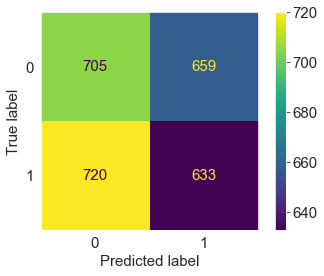

In [36]:
Fbeta_Test_Score = fbeta_score(y_train, clusters_KM, beta=0.5)
cm = confusion_matrix(y_train, clusters_KM)
cm_display = ConfusionMatrixDisplay(cm).plot()
accy = accuracy_score(y_train, clusters)
recall = recall_score(y_train, clusters)
precision = precision_score(y_train, clusters)
plt.grid(b=None)
print(Fbeta_Test_Score,accy,recall,precision)
print('    ETM- Strangles- Confusion Matrix')

In [37]:
#Our clustering with k=2 does slightly better than chance. Nothing too good.

#CONVERT 0s to 1s and 1s to 0s
indices_one = clusters == 1
indices_zero = clusters == 0
clusters[indices_one] = 0 # replacing 1s with 0s
clusters[indices_zero] = 1 # replacing 0s with 1s

Fbeta_Test_Score = fbeta_score(y_train, clusters, beta=0.5)
cm = confusion_matrix(y_train, clusters)
cm_display = ConfusionMatrixDisplay(cm).plot()
accy = accuracy_score(y_train, clusters)
recall = recall_score(y_train, clusters)
precision = precision_score(y_train, clusters)
plt.grid(b=None)
print(Fbeta_Test_Score,accy,recall,precision)
print('    ETM- Strangles- Confusion Matrix')

https://towardsdatascience.com/v-measure-an-homogeneous-and-complete-clustering-ab5b1823d0ad \
The adjusted Rand Index (ARI) should be interpreted as follows:

ARI >= 0.90 excellent recovery; 0.80 =< ARI < 0.90 good recovery; 0.65 =< ARI < 0.80 moderate recovery; ARI < 0.65 poor recovery.

As the confidence interval is based on the approximation to the Normal distribution, it is recommended to trust in the confidence interval only in cases of total number of object clustered greater than 100. \
Negative ARI says that the agreement is less than what is expected from a random result. This means the results are 'orthogonal' or 'complementary' to some extend. \
The adjusted Rand index is the corrected-for-chance version of the Rand index. Such a correction for chance establishes a baseline by using the expected similarity of all pair-wise comparisons between clusterings specified by a random model. \

<b> Fowlkes mainly evaluates similarity between two clusters (binary setting) <b> <b>

The Fowlkes-Mallows Score is an evaluation metric to evaluate the similarity among clusterings obtained after applying different clustering algorithms. Although technically it is used to quantify the similarity between two clusterings, it is typically used to evaluate the clustering performance of a clustering algorithm by assuming the second clustering to be the ground-truth ie the observed data and assuming it to be the perfect clustering.

In [286]:
#Cluster Performance Scores KM ONLY
print(v_measure_score(y_train,clusters_KM))
print(homogeneity_score(y_train,clusters_KM))
print(completeness_score(y_train,clusters_KM))
print(adjusted_rand_score(y_train,clusters_KM))
print(fowlkes_mallows_score(y_train,clusters_KM))

0.00016916566163020438
0.00016902040040523762
0.00016931117275368886
-0.00013967750137508132
0.5003491426015925


In [ ]:
#Our clustering performance is quite poor as you can see from the results above

In [40]:
FIT = kmeans.fit(X)

In [41]:
FIT.cluster_centers_

array([[0.5430216 , 0.46701636, 0.39929447, 0.43797743, 0.67747886,
        0.65006323, 0.69935846, 0.6452877 , 0.76288241, 0.61610287,
        0.76065215, 0.75285388, 0.54538178, 0.48471868, 0.41146495,
        0.62593642, 0.51082122, 0.17903893, 0.62073959, 0.49628846,
        0.49944291, 0.49551927, 0.51141324, 0.52078997, 0.61840506,
        0.38159495, 0.30827591, 0.70811405],
       [0.38843378, 0.38336528, 0.34953873, 0.33737723, 0.44524598,
        0.37017032, 0.41025239, 0.37717648, 0.20635314, 0.42900864,
        0.20317642, 0.21129799, 0.36665644, 0.34690496, 0.33217279,
        0.46904711, 0.40572543, 0.21140955, 0.33382494, 0.43372466,
        0.44042807, 0.43108819, 0.40112537, 0.40455481, 0.36514446,
        0.63485551, 0.35484959, 0.28220728]])

In [42]:
FIT.labels_

array([1, 1, 1, ..., 0, 0, 0])

In [43]:
kmeans = KMeans(
        n_clusters=3, init="k-means++",
        n_init=10,
        tol=1e-04, random_state=42
    )
kmeans.fit(X)

KMeans(n_clusters=3, random_state=42)

In [44]:
clusters = kmeans.fit_predict(X)

In [45]:
pd.Series(kmeans.labels_).value_counts()

0    961
2    944
1    812
dtype: int64

In [46]:
kmeans.cluster_centers_

array([[0.46938376, 0.42838082, 0.37749757, 0.39147972, 0.57990152,
        0.52638572, 0.55572895, 0.51486113, 0.46479126, 0.52673216,
        0.45922043, 0.45836113, 0.45831873, 0.41828893, 0.35149921,
        0.55023804, 0.48776883, 0.12770343, 0.46957784, 0.46829699,
        0.47266534, 0.46710834, 0.4587272 , 0.46786234, 0.4920277 ,
        0.50797229, 0.19176566, 0.49364828],
       [0.35326285, 0.36151987, 0.33458113, 0.3123572 , 0.39338222,
        0.30669341, 0.35416813, 0.31865106, 0.12037067, 0.38785571,
        0.11637569, 0.12676763, 0.32734544, 0.31246134, 0.32540494,
        0.43478823, 0.36931288, 0.25715682, 0.28446279, 0.4168338 ,
        0.42370627, 0.41453987, 0.3735287 , 0.37361159, 0.30837942,
        0.69162055, 0.44075045, 0.20909924],
       [0.56979829, 0.48269259, 0.40910315, 0.45578788, 0.70358654,
        0.68854695, 0.74711966, 0.6923611 , 0.85790978, 0.64754704,
        0.85930384, 0.85056672, 0.57713888, 0.51204329, 0.43809803,
        0.65285843, 0.5122

In [47]:
kmeans.cluster_centers_[:,0]

array([0.46938376, 0.35326285, 0.56979829])

In [48]:
kmeans.cluster_centers_[:,1]

array([0.42838082, 0.36151987, 0.48269259])

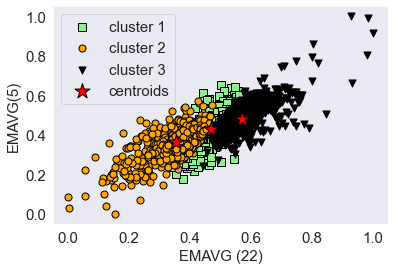

In [49]:
#let’s visualize the clusters that k-means identified in the dataset together with the cluster centroids. 
# These are stored under the cluster_centers_ attribute of the fitted KMeans object:
# plot the 4 clusters
plt.scatter(
    X[clusters == 0, 0], X[clusters == 0, 1],
    s=50, c='lightgreen',
    marker='s', edgecolor='black',
    label='cluster 1'
)

plt.scatter(
    X[clusters == 1, 0], X[clusters == 1, 1],
    s=50, c='orange',
    marker='o', edgecolor='black',
    label='cluster 2'
)

plt.scatter(
    X[clusters == 2, 0], X[clusters == 2, 1],
    s=50, c='black',
    marker='v', edgecolor='black',
    label='cluster 3'
)

# plt.scatter(
#     X[clusters == 3, 0], X[clusters == 3, 1],
#     s=50, c='lightblue',
#     marker='v', edgecolor='blue',
#     label='cluster 4'
# )

# plot the centroids
plt.scatter(
    kmeans.cluster_centers_[:, 0], kmeans.cluster_centers_[:, 1],
    s=250, marker='*',
    c='red', edgecolor='black',
    label='centroids'
)

plt.xlabel(str(Feature_Names[0]))
plt.ylabel(str(Feature_Names[1]))
plt.legend(scatterpoints=1)
plt.grid()
plt.show()

for i in range(28):
    for j in range(28):
        print(i,j)
        plt.scatter(
        X[clusters == 0, i], X[clusters == 0, j],
        s=50, c='lightgreen',
        marker='s', edgecolor='black',
        label='cluster 1'
        )

        plt.scatter(
            X[clusters == 1, i], X[clusters == 1, j],
            s=50, c='orange',
            marker='o', edgecolor='black',
            label='cluster 2'
        )

        plt.scatter(
            X[clusters == 2, i], X[clusters == 2, j],
            s=50, c='black',
            marker='v', edgecolor='black',
            label='cluster 3'
        )

        plt.scatter(
            X[clusters == 3, i], X[clusters == 3, j],
            s=50, c='lightblue',
            marker='v', edgecolor='blue',
            label='cluster 4'
        )

        # plot the centroids
        plt.scatter(
            kmeans.cluster_centers_[:, i], kmeans.cluster_centers_[:, j],
            s=250, marker='*',
            c='red', edgecolor='black',
            label='centroids'
        )

        plt.legend(scatterpoints=1)
        plt.xlabel(str(Feature_Names[i]))
        plt.ylabel(str(Feature_Names[j]))
        plt.grid()
        plt.show()


Text(0.4, 1.02, 'KM Clustering - EMAVG(5) vs EMAVG(22)')

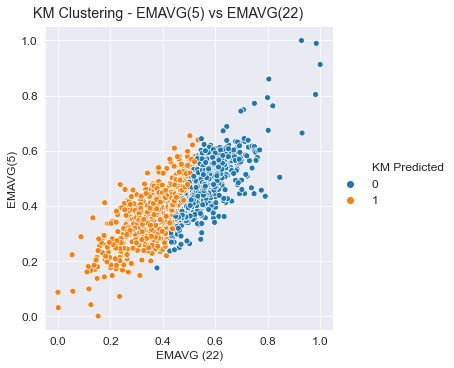

In [359]:
ALL_FEATURES = pd.DataFrame(X, columns=Feature_Names)
ALL_FEATURES['KM Predicted'] = clusters_KM
#sns.pairplot(ALL_FEATURES, hue="KM Predicted", diag_kind= 'kde')
g = sns.relplot(data=ALL_FEATURES,x='EMAVG (22)', y='EMAVG(5)', hue= 'KM Predicted', kind='scatter')
#leg = g._legend
#leg.set_bbox_to_anchor([0.85, 0.35])  # coordinates of lower left of bounding box
#leg._loc = 2  # if required you can set the loc
g.fig.suptitle("KM Clustering - EMAVG(5) vs EMAVG(22)", x=0.4, y=1.02)

Text(0.45, 1.02, 'Truth Labels - EMAVG(5) vs EMAVG(22)')

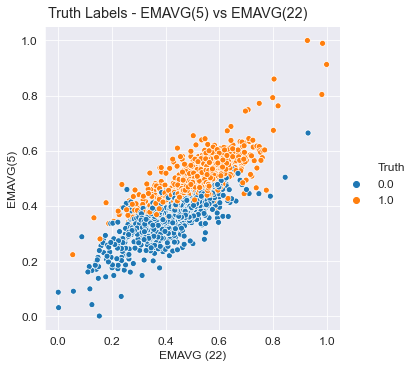

In [360]:
ALL_FEATURES['Truth'] = y_train
g = sns.relplot(data=ALL_FEATURES,x='EMAVG (22)', y='EMAVG(5)', hue= 'Truth', kind='scatter')
#leg = g._legend
#leg.set_bbox_to_anchor([0.85, 0.35])  # coordinates of lower left of bounding box
#leg._loc = 2  # if required you can set the loc
g.fig.suptitle("Truth Labels - EMAVG(5) vs EMAVG(22)", x=0.45, y=1.02)

# Expectation Maximization

In [50]:
from sklearn.mixture import GaussianMixture
from sklearn.mixture import GaussianMixture as GMM

gmm = GaussianMixture(n_components = 3)
gmm_y = gmm.fit_predict(X)

labels = np.zeros_like(clusters)
for i in range(4):
    cat = (gmm_y == i)
    labels[cat] = mode(iris.target[cat])[0]

In [51]:
def SelBest(arr:list, X:int)->list:
    '''
    returns the set of X configurations with shorter distance
    '''
    dx=np.argsort(arr)[:X]
    return arr[dx]

In [52]:
#load out dataset
embeddings=np.load('embeddings.npy')
embeddings.shape

(4866, 2)

In [53]:
n_clusters=np.arange(2, 20)
sils=[]
sils_err=[]
iterations=20
for n in n_clusters:
    tmp_sil=[]
    for _ in range(iterations):
        gmm=GMM(n, n_init=2).fit(embeddings) 
        labels=gmm.predict(embeddings)
        sil=metrics.silhouette_score(embeddings, labels, metric='euclidean')
        tmp_sil.append(sil)
    val=np.mean(SelBest(np.array(tmp_sil), int(iterations/5)))
    err=np.std(tmp_sil)
    sils.append(val)
    sils_err.append(err)

In [54]:
X.shape

(2717, 28)

#### Silohuette Coefficient
https://towardsdatascience.com/gaussian-mixture-model-clusterization-how-to-select-the-number-of-components-clusters-553bef45f6e4

In [55]:
n_clusters=np.arange(2, 16)
sils=[]
sils_err=[]
iterations=20
for n in n_clusters:
    tmp_sil=[]
    for _ in range(iterations):
        gmm=GaussianMixture(n, n_init=2).fit(X) 
        labels=gmm.predict(X)
        sil=metrics.silhouette_score(X, labels, metric='euclidean')
        tmp_sil.append(sil)
    val=np.mean(SelBest(np.array(tmp_sil), int(iterations/5)))
    err=np.std(tmp_sil)
    sils.append(val)
    sils_err.append(err)

Text(0, 0.5, 'Silhouette Score')

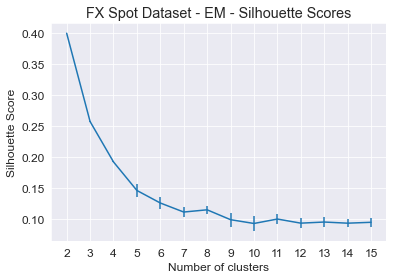

In [362]:
plt.errorbar(n_clusters, sils, yerr=sils_err)
plt.title("FX Spot Dataset - EM - Silhouette Scores")
plt.xticks(n_clusters)
plt.xlabel("Number of clusters")
plt.ylabel("Silhouette Score")

In [57]:
# For Silhouette score the higher the better so k=2 is best

#### Distance Between GMMs

In [58]:
def gmm_js(gmm_p, gmm_q, n_samples=10**5):
    X = gmm_p.sample(n_samples)[0]
    log_p_X = gmm_p.score_samples(X)
    log_q_X = gmm_q.score_samples(X)
    log_mix_X = np.logaddexp(log_p_X, log_q_X)

    Y = gmm_q.sample(n_samples)[0]
    log_p_Y = gmm_p.score_samples(Y)
    log_q_Y = gmm_q.score_samples(Y)
    log_mix_Y = np.logaddexp(log_p_Y, log_q_Y)

    return np.sqrt((log_p_X.mean() - (log_mix_X.mean() - np.log(2))
            + log_q_Y.mean() - (log_mix_Y.mean() - np.log(2))) / 2)

In [59]:
n_clusters=np.arange(2, 16)
iterations=20
results=[]
res_sigs=[]
for n in n_clusters:
    dist=[]
    
    for iteration in range(iterations):
        train, test=train_test_split(X, test_size=0.5)
        
        gmm_train=GaussianMixture(n, n_init=2).fit(train) 
        gmm_test=GaussianMixture(n, n_init=2).fit(test) 
        dist.append(gmm_js(gmm_train, gmm_test))
    selec=SelBest(np.array(dist), int(iterations/5))
    result=np.mean(selec)
    res_sig=np.std(selec)
    results.append(result)
    res_sigs.append(res_sig)

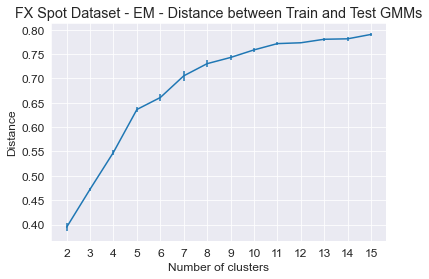

In [363]:
plt.errorbar(n_clusters, results, yerr=res_sigs)
plt.title("FX Spot Dataset - EM - Distance between Train and Test GMMs")
plt.xticks(n_clusters)
plt.xlabel("Number of clusters")
plt.ylabel("Distance")
plt.show()

In [61]:
#lower the better so k=2 is best

####  Bayesian information criterion (BIC)

In [62]:
n_clusters=np.arange(2, 16)
bics=[]
bics_err=[]
iterations=20
for n in n_clusters:
    tmp_bic=[]
    for _ in range(iterations):
        gmm=GaussianMixture(n, n_init=2).fit(X) 
        
        tmp_bic.append(gmm.bic(X))
    val=np.mean(SelBest(np.array(tmp_bic), int(iterations/5)))
    err=np.std(tmp_bic)
    bics.append(val)
    bics_err.append(err)

Text(0, 0.5, 'BIC Score')

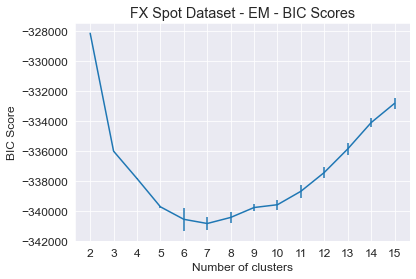

In [367]:
plt.errorbar(n_clusters,bics, yerr=bics_err, label='BIC')
plt.title("FX Spot Dataset - EM - BIC Scores")
plt.xticks(n_clusters)
plt.xlabel("Number of clusters")
plt.ylabel("BIC Score")

In [ ]:
# For BIC score, the lower the better so optimal k would be k=7

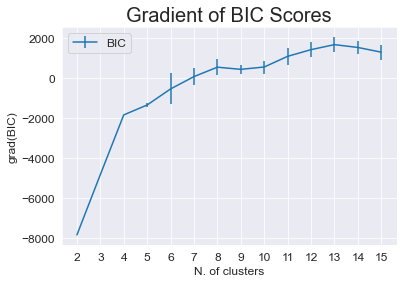

In [366]:
plt.errorbar(n_clusters, np.gradient(bics), yerr=bics_err, label='BIC')
plt.title("Gradient of BIC Scores", fontsize=20)
plt.xticks(n_clusters)
plt.xlabel("N. of clusters")
plt.ylabel("grad(BIC)")
plt.legend()

In [ ]:
# To test the clustering quality of EM, we can take the average of the probabilities of being assigned to the most probable
# cluster. A perfect score will be one, a bad score will be 0.50 (assuming k=2 clusters)

In [ ]:
#Lets create our EM with 2 n components based on the results we obtained above
EM =GaussianMixture(2, n_init=2).fit(X) #Fit our EM model with 2 components
clusters_EM = EM.predict(X) # generate cluster assignmant based on our data and the two clusters
clusters_EM_prob = EM.predict_proba(X) #generate probability of cluster assignmnet

In [294]:
#Idea is to find the max prob of each row and average them. A value close to 1 will mean that the clustering is good because
# the algorithm is quite confident that a datapoint will belong to a specific cluster. On the other hand, an average prob
# value of 0.5 is quite poor because it means the algo is only slightly better than chance in terms of its confidence.

# axis=1 to find max from each row
np.amax(clusters_EM_prob, axis=1).mean()

#This is a GOOD value! :) Now lets look at the cluster PMs

0.9876610335174097

In [296]:
#Cluster Performance Scores EM ONLY
print(v_measure_score(y_train,clusters_EM))
print(homogeneity_score(y_train,clusters_EM))
print(completeness_score(y_train,clusters_EM))
print(adjusted_rand_score(y_train,clusters_EM))
print(fowlkes_mallows_score(y_train,clusters_EM))

0.0006568515418914263
0.0006558032538154533
0.0006579031866670742
0.0005223430532654371
0.5011893566499895


In [299]:
#Quite poor results as well. Similar to KM only.
#Something worth mentioning is that the shape of the clusters with EM are way less sphrical than with KM because EM uses a 
# probabilistic approach rather than a hard assignment based on a certain boundary like KM does. 
#Also, EM is more computationally expensive relative to KM.
#If you think that your features will fit well into spherical clusters you should use KM. Otherwise, dont.

Text(0.4, 1.02, 'FX Spot Dataset EM Clustering - EMAVG(5) vs EMAVG(22)')

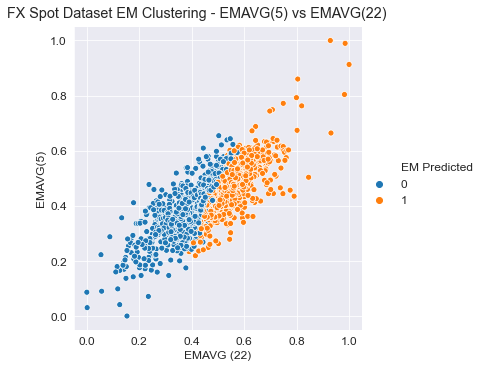

In [370]:
ALL_FEATURES = pd.DataFrame(X, columns=Feature_Names)
ALL_FEATURES['EM Predicted'] = clusters_EM
#sns.pairplot(ALL_FEATURES, hue="EM Predicted", diag_kind= 'kde')
g = sns.relplot(data=ALL_FEATURES,x='EMAVG (22)', y='EMAVG(5)', hue= 'EM Predicted', kind='scatter')
g.fig.suptitle("FX Spot Dataset EM Clustering - EMAVG(5) vs EMAVG(22)", x=0.4, y=1.02)

In [ ]:
#Compare EM vs KM vs Truth for three or four pairs

### PCA 
##### Step 1: Reduce Dimensionality

([<matplotlib.axis.XTick at 0x2339ab86ac8>,
 <a list of 20 Text major ticklabel objects>)

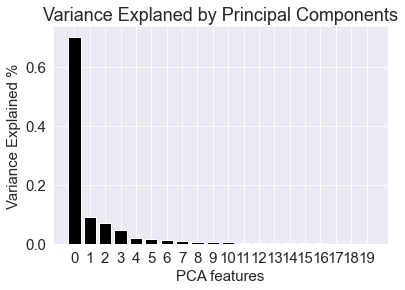

In [350]:
# Create a PCA instance: pca
pca = PCA(n_components=20)
principalComponents = pca.fit_transform(X)
# Plot the explained variances
features = range(pca.n_components_)
plt.bar(features, pca.explained_variance_ratio_, color='black')
plt.xlabel('PCA features')
plt.ylabel('Variance Explained %')
plt.title('Variance Explaned by Principal Components')
plt.xticks(features)

In [371]:
pca.explained_variance_ratio_[:4]

array([0.70240597, 0.0916784 , 0.06895613, 0.04555102])

In [372]:
#The first three PCs explain 86% of variance
sum(pca.explained_variance_ratio_[:3])

0.8630404970074458

#### Find feature importance for each PC using the .components_ attribute

pca.components_ is not other than the Loading Scores. With PCA with SVD (singular value decomposition), the principal components are scaled to 1. Imagine the loading scores as a recipe of a cocktail where our PC1 is made with (loading scores for PC1) 0.97 part of Gen1 and 0.242 parts of Gen2, and PC2 is made -0.242 parts of Gen1 and 0.97 of Gen2 (loading scores for PC2).

This is indeed giving us the called Singlular Vector or eigenvector for each component ( the loading scores are the coefficients of each variable for the first component versus the coefficients for the second component).

This also indicates which variables have the largest effect on each component. Loadings can range from -1 to 1. Loadings close to -1 or 1 indicate that the variable strongly influences the component. Loadings close to 0 indicate that the variable has a weak influence on the component. Evaluating the loadings can also help you characterize each component in terms of the variables.

In [67]:
#20 PCs by 28 features
# the .componentes_ attribute of PCS gives us an eigenvector for each PC.
pd.DataFrame(abs(pca.components_[0:3]),index=['PC1','PC2','PC3'])

,0,1,2,3,4,5,6,7,8,9,...,18,19,20,21,22,23,24,25,26,27
PC1,0.122381,0.071199,0.045951,0.082893,0.179693,0.218163,0.221046,0.213341,0.395204,0.146089,...,0.212291,0.054432,0.051823,0.055537,0.090758,0.096601,0.204935,0.204935,0.032819,0.309942
PC2,0.059364,0.192164,0.224517,0.165743,0.056669,0.090050,0.119526,0.149516,0.257418,0.001857,...,0.328747,0.196482,0.182192,0.205714,0.158492,0.166889,0.294550,0.294550,0.086565,0.190209
PC3,0.038901,0.084945,0.050266,0.094085,0.544578,0.410614,0.155267,0.107546,0.214703,0.020307,...,0.167759,0.083945,0.082641,0.082722,0.090445,0.077325,0.076421,0.076421,0.291252,0.317303


Text(0.5, 1.0, 'Feature Importance for First 3 Principal Components')

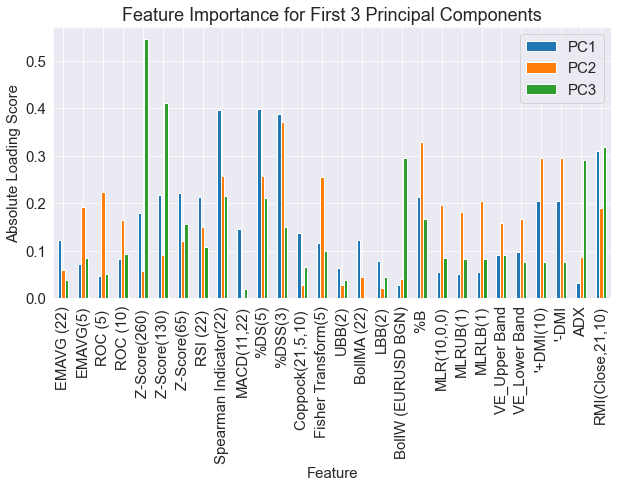

In [68]:
pd.DataFrame(abs(pca.components_[0:3]), columns=Feature_Names, index=['PC1','PC2','PC3']).transpose().plot(
    kind='bar',figsize=(10,5))
plt.ylabel('Absolute Loading Score')
plt.xlabel('Feature')
plt.title('Feature Importance for First 3 Principal Components')

In [69]:
#The first three PCs explain 86% of variance
sum(pca.explained_variance_ratio_[:3])

0.8630404970074467

Fig. 1 shows that the first three components explain the majority of the variance in our data. For this visualization use case, we will quickly plot just the first two. We do this to notice if there are any clear clusters.

In [70]:
# Save components to a DataFrame
PCA_components = pd.DataFrame(principalComponents)

Text(0, 0.5, 'PC 2')

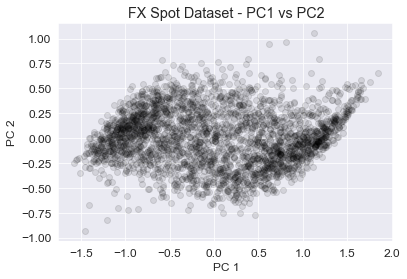

In [374]:
plt.scatter(PCA_components[0], PCA_components[1], alpha=.1, color='black')
plt.title('FX Spot Dataset - PC1 vs PC2')
plt.xlabel('PC 1')
plt.ylabel('PC 2')

Text(0, 0.5, 'PC 3')

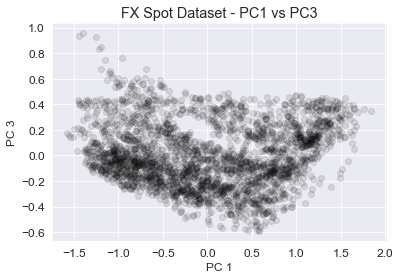

In [375]:
plt.scatter(PCA_components[0], PCA_components[2], alpha=.1, color='black')
plt.title('FX Spot Dataset - PC1 vs PC3')
plt.xlabel('PC 1')
plt.ylabel('PC 3')

Text(0, 0.5, 'PC 3')

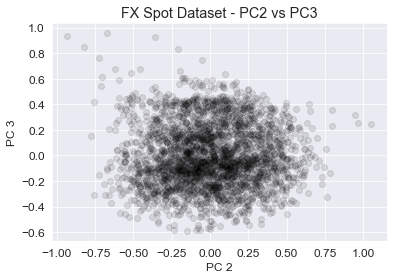

In [376]:
plt.scatter(PCA_components[1], PCA_components[2], alpha=.1, color='black')
plt.title('FX Spot Dataset - PC2 vs PC3')
plt.xlabel('PC 2')
plt.ylabel('PC 3')

Fig. 2 shows at least two distinguishable clusters. This factoid tells us that the observations in the dataset can be grouped. Because each observation in the data is a diet, lab, and physical exam for one person, we could say that the clusters represent different groups of people. It’s important to note that we do not have a target variable by which to label these groups, so we do not know exactly what these labels are. In a utopian situation, this type of analysis would let us see the sample population segregated by health condition. Fig. 2 does not show all the meaningful principal components, however. To visualize the rest of the reduced dataset with much greater granularity, we will use k-means clustering.

##### Step 2: Find Clusters using KM
In this step, we will use k-means clustering to view the top three PCA components. To do this, we will first fit these principal components to the k-means algorithm and determine the best number of clusters. Determining the ideal number of clusters for our k-means model can be done by measuring the sum of the squared distances to the nearest cluster center aka inertia. Much like the scree plot in fig. 1 for PCA, the k-means scree plot below indicates the percentage of variance explained, but in slightly different terms, as a function of the number of clusters.

In [72]:
#We are only using the first 3 PCs. With only those 3 we can extract 86% of variance
PCA_components.iloc[:,:3].head()

,0,1,2
0,0.270124,0.116991,-0.460218
1,0.363206,0.161269,-0.470102
2,0.524426,0.215202,-0.463274
3,0.660978,0.220724,-0.447788
4,0.669442,0.077271,-0.439477


In [387]:
inertia = []
sse, db, slc = {}, {}, {}

for k in range(2,11):
    
    #Create KM model instance
    kmeans = KMeans(
        n_clusters=k, init="k-means++",
        n_init=10,
        tol=1e-04, random_state=42)
    
    
    # Fit model to samples
    #We are only using the first 3 PCs. With only those 3 we can extract 86% of variance
    FIT = kmeans.fit(PCA_components.iloc[:,:3])
    inertia.append(kmeans.inertia_)
    clusters = FIT.labels_
    sse[k] = FIT.inertia_
    db[k] = davies_bouldin_score(PCA_components.iloc[:,:3], clusters)
    slc[k] = silhouette_score(PCA_components.iloc[:,:3], clusters)

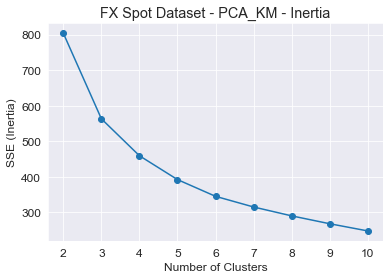

In [390]:
#ELBOW
sns.set_style("darkgrid")
font = {'size'   : 12}
plt.rc('font', **font)
plt.plot(list(sse.keys()), list(sse.values()), marker='o')
plt.xlabel('Number of Clusters')
plt.ylabel('SSE (Inertia)')
plt.title('FX Spot Dataset - PCA_KM - Inertia')
plt.show()

In [391]:
# 4 seems to be the optimal k accoridng to the elbow method

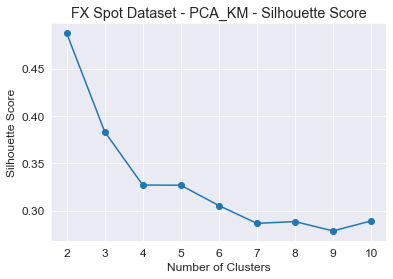

In [392]:
plt.plot(list(slc.keys()), list(slc.values()), marker='o')
plt.xlabel('Number of Clusters')
plt.ylabel('Silhouette Score')
plt.title('FX Spot Dataset - PCA_KM - Silhouette Score')
plt.show()

In [ ]:
# Silhouette score is the higher the better so optimal number of clusters is k=2

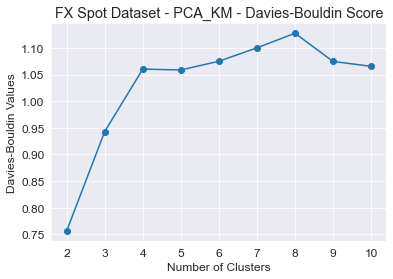

In [393]:
plt.plot(list(db.keys()), list(db.values()), marker='o')
plt.xlabel('Number of Clusters')
plt.ylabel('Davies-Bouldin Values')
plt.title('FX Spot Dataset - PCA_KM - Davies-Bouldin Score')
plt.show()

In [ ]:
#For DB score the lower the better, so k=2
#Overall we should pick k=2 because two out of three metrics evaluated suggest k=2 is best

##### Step 3 : Visualize and Interpret the Clusters PCA_KM

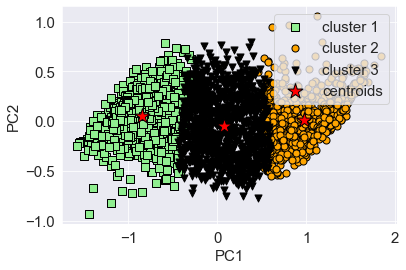

In [74]:
#let’s visualize the clusters that k-means identified in the dataset together with the cluster centroids. 
# These are stored under the cluster_centers_ attribute of the fitted KMeans object:
# plot the 2 clusters
model = KMeans(n_clusters=2)
#Use first 3 PCs
model.fit(PCA_components.iloc[:,:3])

XX = np.array(PCA_components.iloc[:,:3])
clusters = model.fit_predict(XX)

plt.scatter(
    XX[clusters == 0, 0], XX[clusters == 0, 1],
    s=50, c='lightgreen',
    marker='s', edgecolor='black',
    label='cluster 1'
)

plt.scatter(
    XX[clusters == 1, 0], XX[clusters == 1, 1],
    s=50, c='orange',
    marker='o', edgecolor='black',
    label='cluster 2'
)

plt.scatter(
    XX[clusters == 2, 0], XX[clusters == 2, 1],
    s=50, c='black',
    marker='v', edgecolor='black',
    label='cluster 3'
)

# plt.scatter(
#     X[clusters == 3, 0], X[clusters == 3, 1],
#     s=50, c='lightblue',
#     marker='v', edgecolor='blue',
#     label='cluster 4'
# )

# plot the centroids
plt.scatter(
    model.cluster_centers_[:, 0], model.cluster_centers_[:, 1],
    s=250, marker='*',
    c='red', edgecolor='black',
    label='centroids'
)

plt.ylabel('PC2')
plt.xlabel('PC1')
plt.legend(scatterpoints=1)
plt.grid(True)
sns.set_style("darkgrid")
plt.show()

In [396]:
THREE_PCs

,0,1,2,K-Means Predicted
0,0.270124,0.116991,-0.460218,1
1,0.363206,0.161269,-0.470102,1
2,0.524426,0.215202,-0.463274,1
3,0.660978,0.220724,-0.447788,1
4,0.669442,0.077271,-0.439477,1
...,...,...,...,...
2712,-1.070738,0.124139,-0.068637,0
2713,-1.001387,0.185723,-0.063712,0
2714,-1.079373,0.088708,-0.076995,0
2715,-1.040056,0.141881,-0.057933,0


Text(0.4, 1.02, 'FX Spot Dataset - PCA_KM Clustering')

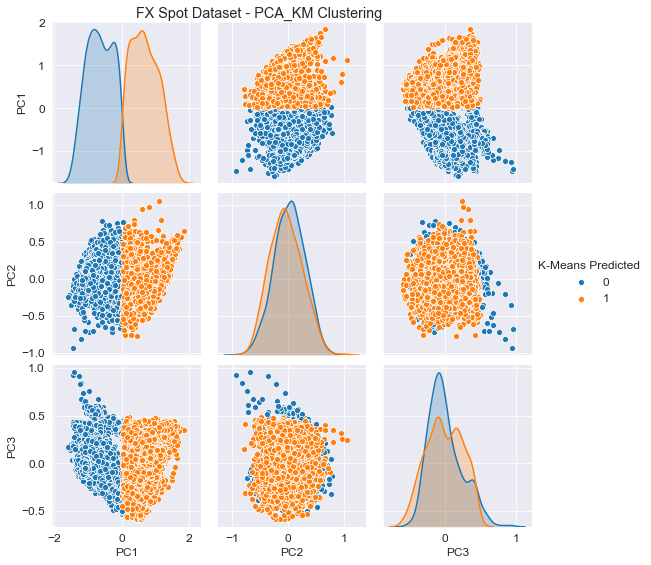

In [403]:
#Visualize Cluster distribution based on PCA
#Print out diagonal labels based on K= optimal k
THREE_PCs = pd.DataFrame(np.array(PCA_components.iloc[:,:3]),columns=['PC1','PC2','PC3'])
kmeans = KMeans(n_clusters = 2, init = 'k-means++',random_state=1).fit(np.array(THREE_PCs))
clusters_PCA_KM = kmeans.labels_
THREE_PCs['K-Means Predicted'] = clusters_PCA_KM
g = sns.pairplot(THREE_PCs, hue="K-Means Predicted", diag_kind= 'kde')
g.fig.suptitle("FX Spot Dataset - PCA_KM Clustering", x=0.4, y=1.02)

Text(0.4, 1.02, 'FX Spot Dataset - PCA True Labels')

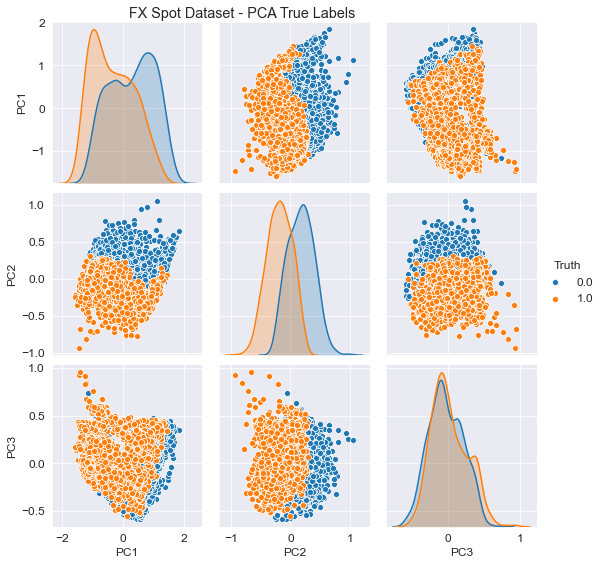

In [404]:
TRUTH_LABELS = pd.DataFrame(np.array(PCA_components.iloc[:,:3]),columns=['PC1','PC2','PC3'])
TRUTH_LABELS['Truth'] = y_train
g = sns.pairplot(TRUTH_LABELS, hue="Truth", diag_kind= 'kde')
g.fig.suptitle("FX Spot Dataset - PCA True Labels", x=0.4, y=1.02)

In [405]:
#Cluster Performance Scores PCA_KM
print(v_measure_score(y_train,clusters_PCA_KM))
print(homogeneity_score(y_train,clusters_PCA_KM))
print(completeness_score(y_train,clusters_PCA_KM))
print(adjusted_rand_score(y_train,clusters_PCA_KM))
print(fowlkes_mallows_score(y_train,clusters_PCA_KM))

0.00022108617227683218
0.00022092400081450707
0.00022124858200120895
-6.824879765899712e-05
0.5002981885238215


##### Step 2 : Visualize and Interpret the Clusters PCA_EM

In [407]:
#Silhouette coefficient
n_clusters=np.arange(2, 16)
sils=[]
sils_err=[]
iterations=20
for n in n_clusters:
    tmp_sil=[]
    for _ in range(iterations):
        gmm=GaussianMixture(n, n_init=2).fit(PCA_components.iloc[:,:3]) 
        labels=gmm.predict(PCA_components.iloc[:,:3])
        sil=metrics.silhouette_score(PCA_components.iloc[:,:3], labels, metric='euclidean')
        tmp_sil.append(sil)
    val=np.mean(SelBest(np.array(tmp_sil), int(iterations/5)))
    err=np.std(tmp_sil)
    sils.append(val)
    sils_err.append(err)

Text(0, 0.5, 'Silhouette Score')

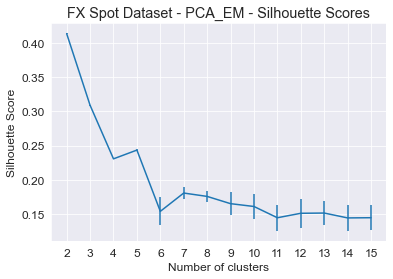

In [411]:
plt.errorbar(n_clusters, sils, yerr=sils_err)
plt.title("FX Spot Dataset - PCA_EM - Silhouette Scores")
plt.xticks(n_clusters)
plt.xlabel("Number of clusters")
plt.ylabel("Silhouette Score")

In [412]:
#Distance between train and test GMMs
n_clusters=np.arange(2, 16)
iterations=20
results=[]
res_sigs=[]
for n in n_clusters:
    dist=[]
    
    for iteration in range(iterations):
        train, test=train_test_split(PCA_components.iloc[:,:3], test_size=0.5)
        
        gmm_train=GaussianMixture(n, n_init=2).fit(train) 
        gmm_test=GaussianMixture(n, n_init=2).fit(test) 
        dist.append(gmm_js(gmm_train, gmm_test))
    selec=SelBest(np.array(dist), int(iterations/5))
    result=np.mean(selec)
    res_sig=np.std(selec)
    results.append(result)
    res_sigs.append(res_sig)

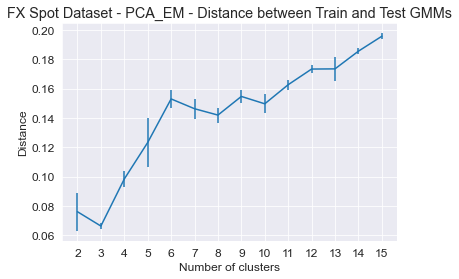

In [413]:
plt.errorbar(n_clusters, results, yerr=res_sigs)
plt.title("FX Spot Dataset - PCA_EM - Distance between Train and Test GMMs")
plt.xticks(n_clusters)
plt.xlabel("Number of clusters")
plt.ylabel("Distance")
plt.show()

In [414]:
# BIC
n_clusters=np.arange(2, 16)
bics=[]
bics_err=[]
iterations=20
for n in n_clusters:
    tmp_bic=[]
    for _ in range(iterations):
        gmm=GaussianMixture(n, n_init=2).fit(PCA_components.iloc[:,:3]) 
        
        tmp_bic.append(gmm.bic(PCA_components.iloc[:,:3]))
    val=np.mean(SelBest(np.array(tmp_bic), int(iterations/5)))
    err=np.std(tmp_bic)
    bics.append(val)
    bics_err.append(err)

Text(0, 0.5, 'BIC Score')

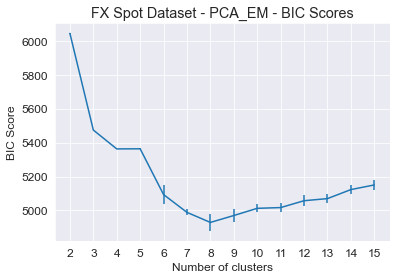

In [415]:
plt.errorbar(n_clusters,bics, yerr=bics_err, label='BIC')
plt.title("FX Spot Dataset - PCA_EM - BIC Scores")
plt.xticks(n_clusters)
plt.xlabel("Number of clusters")
plt.ylabel("BIC Score")

In [416]:
#Lets create our EM with 2 n components based on the results we obtained above
PCA_EM =GaussianMixture(2, n_init=2).fit(PCA_components.iloc[:,:3]) #Fit our EM model with 2 components, feeding the 3 PCs as our X
clusters_PCA_EM = PCA_EM.predict(PCA_components.iloc[:,:3]) # generate cluster assignmant based on our data and the two clusters
clusters_PCA_EM_prob = PCA_EM.predict_proba(PCA_components.iloc[:,:3]) #generate probability of cluster assignmnet

In [417]:
#Idea is to find the max prob of each row and average them. A value close to 1 will mean that the clustering is good because
# the algorithm is quite confident that a datapoint will belong to a specific cluster. On the other hand, an average prob
# value of 0.5 is quite poor because it means the algo is only slightly better than chance in terms of its confidence.

# axis=1 to find max from each row
np.amax(clusters_PCA_EM_prob, axis=1).mean()
#This is a GOOD value! :) Now lets look at the cluster PMs

0.9588731143796336

In [418]:
#Cluster Performance Scores PCA_EM
print(v_measure_score(y_train,clusters_PCA_EM))
print(homogeneity_score(y_train,clusters_PCA_EM))
print(completeness_score(y_train,clusters_PCA_EM))
print(adjusted_rand_score(y_train,clusters_PCA_EM))
print(fowlkes_mallows_score(y_train,clusters_PCA_EM))

0.0001747219151557526
0.00016916358782404013
0.00018065791986328415
-8.716547673629365e-05
0.5210615216027128


In [ ]:
#Evaluate Results

Text(0.4, 1.02, 'FX Spot Dataset - PCA_EM Clustering')

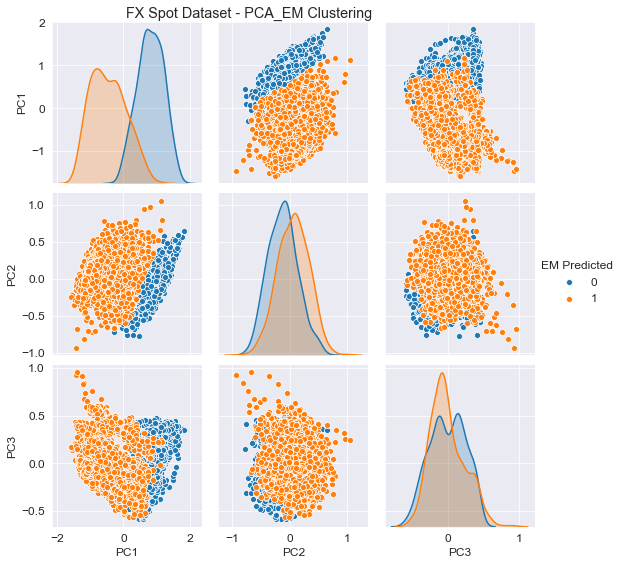

In [420]:
#Visualize Cluster distribution based on PCA
#Print out diagonal labels based on K= optimal k
THREE_PCs = pd.DataFrame(np.array(PCA_components.iloc[:,:3]),columns=['PC1','PC2','PC3'])
gmm = GaussianMixture(2, n_init=2).fit(np.array(THREE_PCs)) 
THREE_PCs['EM Predicted'] = clusters_PCA_EM
g = sns.pairplot(THREE_PCs, hue="EM Predicted", diag_kind= 'kde')
g.fig.suptitle("FX Spot Dataset - PCA_EM Clustering", x=0.4, y=1.02)

In [421]:
# Make a table comparing PMs of PCA_KM vs PCA_EM

# ICA

In [77]:
#HOW TO PICK OPTIMAL NUMBER OF COMPONENTS?
# Do ICA with 2,3,4,5,6,7,8 components. 
# Take average of all ABS(kurtosis) from my produced components.
# The ICA with the highest average component kurtosis is the one with optimal K*

#So find the way to get the kurtosis from the distribution of your NEW feature components. The kurtosis should
# be less gaussian than the kurtosis of the individual features from the original set (aka observable features)
# 

#MENTION that 

In [422]:
#We cerate a function to find the mean absolute kurtosis of all features within a matrix, where the matrix has dimensions
# of N(samples) by X(features)
def Mean_Absolute_Kurtosis(COMPONENTS):
    kurts=[]
    for i in range(COMPONENTS.shape[1]):
        this_absolute_kurtosis = abs(kurtosis(COMPONENTS[:,i]))
        kurts.append(this_absolute_kurtosis)
        #print(this_absolute_kurtosis)
    return np.mean(kurts)    

In [79]:
#We cerate a function to find the mean absolute kurtosis of all features within a matrix, where the matrix has dimensions
# of N(samples) by X(features)
def Mean_Kurtosis(COMPONENTS):
    kurts=[]
    for i in range(COMPONENTS.shape[1]):
        this_absolute_kurtosis = (kurtosis(COMPONENTS[:,i]))
        kurts.append(this_absolute_kurtosis)
        #print(this_absolute_kurtosis)
    return np.mean(kurts)   

In [448]:
# CREATE A FUNCTION TO CALCULATE MEAN MUTUAL INFORMATION between New components, so Xnew(i) vs Xnew(j)
# Remember that S_ = Xnew ;)

def Mean_Mutual_Information_Xnew_vs_Xnew(COMPONENTS):
    MIs=[]
    #Loop through each component and calculate mean MI vs other components in Xnew
    for i in range(COMPONENTS.shape[1]):
        this_Mean_Mutual_Info = mutual_info_regression(COMPONENTS,COMPONENTS[:,i]).mean()
        MIs.append(this_Mean_Mutual_Info)
        
    return np.mean(MIs)  

In [450]:
# CREATE A FUNCTION TO CALCULATE MEAN MUTUAL INFORMATION between original features(X) and new components(S_)
def Mean_Mutual_Information_X_vs_Xnew(X, X_new):
    MIs=[]
    for i in range(X_new.shape[1]):
        this_Mean_Mutual_Info = mutual_info_regression(X, X_new[:,i])
        MIs.append(this_Mean_Mutual_Info)
        #print(this_absolute_kurtosis)
    return np.mean(MIs)

### Calculate MI between S_(i) and S_(j), this should be close to 0

### Calculate MI between S_ and X, this should be as HIGH as possible

In [451]:
# LOOP to obtain 1)Mean Abs Kurt, 2)MI(Xnew,Xnew) and 3)MI(X,Xnew)

KURTOSIS_LIST=[]
MI_XNEW_XNEW=[]
MI_X_XNEW=[]

for i in range(2,19):
    ica = FastICA(n_components=i,max_iter=500,random_state=1)
    S_ = ica.fit_transform(X)  # Reconstruct signals
    A_ = ica.mixing_  # Get estimated mixing matrix
    #Append mean absolut kurtosis
    KURTOSIS_LIST.append(Mean_Absolute_Kurtosis(S_))
    #Append Avg Mutual Info between X_new(i) and X_new(j)
    MI_Xnew_vs_Xnew = Mean_Mutual_Information_Xnew_vs_Xnew(S_)
    MI_XNEW_XNEW.append(MI_Xnew_vs_Xnew)
    #Append Avg Mutual Info between X_(i) and X_new(i)
    MI_X_vs_Xnew = Mean_Mutual_Information_X_vs_Xnew(X, S_)
    MI_X_XNEW.append(MI_X_vs_Xnew)

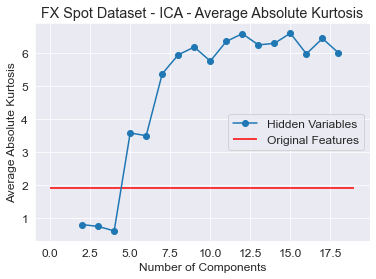

In [452]:
#Make a plot that plots the average absolute kurtosis of the COMPONENTS(hidden variables) as a function of num of components
#Plot Average Abs Kurtosis
plt.plot(list(range(2,19)), KURTOSIS_LIST, marker='o',label='Hidden Variables')
plt.xlabel('Number of Components')
plt.ylabel('Average Absolute Kurtosis')
plt.title('FX Spot Dataset - ICA - Average Absolute Kurtosis')
plt.hlines(Mean_Absolute_Kurtosis(X),0,19,colors='r', label='Original Features')
plt.legend(loc='center right')

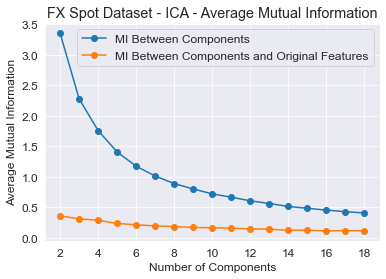

In [454]:
#Make a plot that plots the MI(X,Xnew) and MI(Xnew,Xnew) as a function of num of components
plt.plot(list(range(2,19)), MI_XNEW_XNEW, marker='o',label='MI Between Components')
plt.plot(list(range(2,19)), MI_X_XNEW, marker='o',label='MI Between Components and Original Features')
plt.xlabel('Number of Components')
plt.ylabel('Average Mutual Information')
plt.title('FX Spot Dataset - ICA - Average Mutual Information')
plt.legend(loc='best')

#MEAN KURTOSIS
#Make a plot that plots the average absolute kurtosis of the COMPONENTS(hidden variables) as a function of num of components
KURTOSIS_LIST=[]
for i in range(2,20):
    ica = FastICA(n_components=i,max_iter=500)
    S_ = ica.fit_transform(X)  # Reconstruct signals
    A_ = ica.mixing_  # Get estimated mixing matrix
    KURTOSIS_LIST.append(Mean_Kurtosis(S_))
    

plt.plot(list(range(2,20)), KURTOSIS_LIST, marker='o',label='Hidden Variables')
plt.xlabel('Number of Components')
plt.ylabel('Average Kurtosis')
plt.title('Average Kurtosis')
plt.hlines(Mean_Absolute_Kurtosis(X),0,20,colors='r', label='Original Features')
plt.legend(loc='best')

In [85]:
#Since we want to maximize the non-gausiannness of our hidden variables(components) we should pick the Number of components
# that yields the highest average absolute kurtosis, because the higher the average absolute kurtosis, the less gaussian
# our components are and the idea is that we want to maximize non-gaussianity. That's why average absolute kurtosis is 
# the perfect measure to pick optimal n components, since its a measure of non gaussianity.

#MI(Xnew,Xnew)(blue) drops considerably up to n=10, after that it kind of platoes, we want this to be super low so 12 is ok.

#MI(X,Xnew)(orange) is kind of flattish, we want to maximize this. But 12 is ok cus thats the max kurt number :)

#So we pick 12 as the number of n components

In [460]:
#Mean absoult kurtosis of original features
Mean_Absolute_Kurtosis(X)

1.9042742812453362

In [461]:
# MI between the original features, so X_original vs X_original
Mean_Mutual_Information_Xnew_vs_Xnew(X)

0.6605965691926736

In [455]:
#Set up your final ICA with optimal number of components (12)
ica = FastICA(n_components=12,max_iter=500,random_state=1)
S_ = ica.fit_transform(X)  # Reconstruct signals

#### 2) KM Clustering with ICA

In [457]:
ica = FastICA(n_components=12,max_iter=500, random_state=1)
S_ = ica.fit_transform(X)  # Reconstruct signals
S_.shape

(2717, 12)

In [515]:
#Obtain the inertia, silhuoette and DB index, by feeding in the 12 ICA Components
inertia = []
sse, db, slc = {}, {}, {}

for k in range(2,11):
    
    #Create KM model instance
    kmeans = KMeans(
        n_clusters=k, init="k-means++",
        n_init=10,
        tol=1e-04, random_state=42)
    
    
    # Fit model to samples
    #We are only using the first 3 PCs. With only those 3 we can extract 86% of variance
    FIT = kmeans.fit(S_)
    inertia.append(kmeans.inertia_)
    clusters = FIT.labels_
    sse[k] = FIT.inertia_
    db[k] = davies_bouldin_score(S_, clusters)
    slc[k] = silhouette_score(S_, clusters)

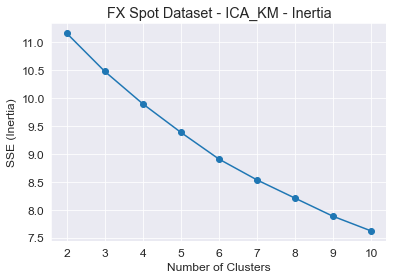

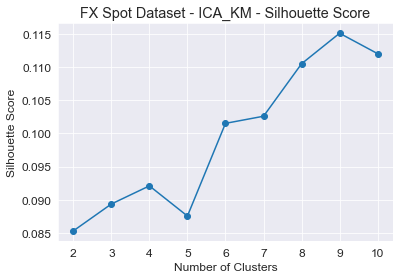

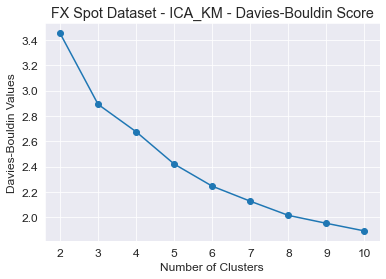

In [516]:
### Elbow Method

sns.set_style("darkgrid")
plt.plot(list(sse.keys()), list(sse.values()), marker='o')
plt.xlabel('Number of Clusters')
plt.ylabel('SSE (Inertia)')
plt.title('FX Spot Dataset - ICA_KM - Inertia')
plt.show()
# 4 Seems to be the best k value according to Elbow method

### Silhouette Analysis

plt.plot(list(slc.keys()), list(slc.values()), marker='o')
plt.xlabel('Number of Clusters')
plt.ylabel('Silhouette Score')
plt.title('FX Spot Dataset - ICA_KM - Silhouette Score')
plt.show()
#For Sillhouette Score the higher the better. It seems like 13 is the best k accoring to sillhouette

### Davies-Bouldin Index

plt.plot(list(db.keys()), list(db.values()), marker='o')
plt.xlabel('Number of Clusters')
plt.ylabel('Davies-Bouldin Values')
plt.title('FX Spot Dataset - ICA_KM - Davies-Bouldin Score')
plt.show()
# For DB Index the lower the better so k=17 seems to be the best value here.

In [ ]:
# We pick 9 as our num of clusters since it has the highest Siluhoette score, and very low inertia and DB Index values

#####  Visualize and Interpret the Clusters

In [466]:
S_.shape

(2717, 12)

Text(0.4, 1.02, 'FX Spot Dataset - ICA_KM Clustering')

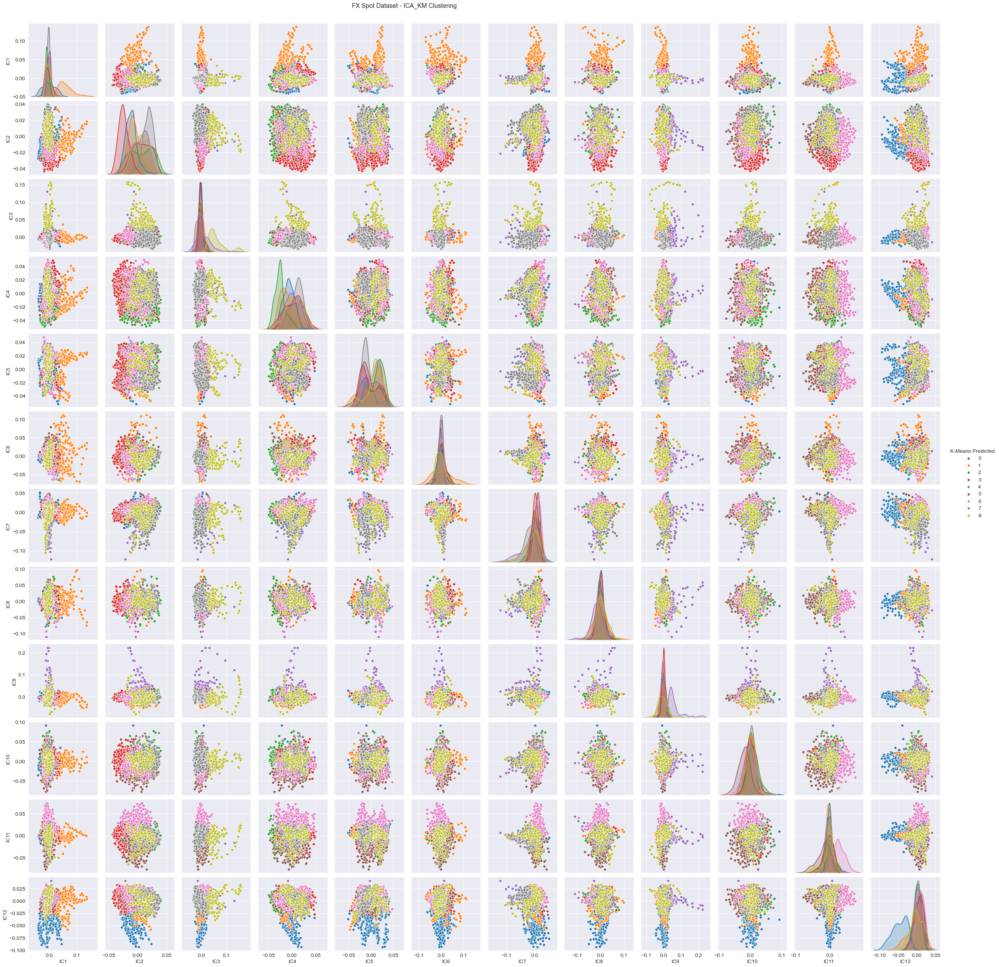

In [467]:
#Visualize Cluster distribution based on ICA
#Print out diagonal labels based on K= optimal k
TWELVE_ICs = pd.DataFrame(S_,columns=['IC1','IC2','IC3','IC4','IC5','IC6','IC7','IC8','IC9','IC10','IC11','IC12'])
kmeans = KMeans(n_clusters = 9, init = 'k-means++',random_state=1).fit(np.array(TWELVE_ICs))
clusters_ICA_KM = kmeans.labels_
TWELVE_ICs['K-Means Predicted'] = clusters_ICA_KM
g = sns.pairplot(TWELVE_ICs, hue="K-Means Predicted", diag_kind= 'kde')
g.fig.suptitle("FX Spot Dataset - ICA_KM Clustering", x=0.4, y=1.02)

#let’s visualize the clusters that k-means identified in the dataset together with the cluster centroids. 
#These are stored under the cluster_centers_ attribute of the fitted KMeans object:
#plot the 3 clusters
model = KMeans(n_clusters=9)
#Use 12 ICs
model.fit(S_)

XX = np.array(S_)
clusters = model.fit_predict(XX)

plt.scatter(
    XX[clusters == 0, 0], XX[clusters == 0, 1],
    s=50, c='lightgreen',
    marker='s', edgecolor='black',
    label='cluster 1'
)

plt.scatter(
    XX[clusters == 1, 0], XX[clusters == 1, 1],
    s=50, c='orange',
    marker='o', edgecolor='black',
    label='cluster 2'
)

plt.scatter(
    XX[clusters == 2, 0], XX[clusters == 2, 1],
    s=50, c='black',
    marker='v', edgecolor='black',
    label='cluster 3'
)

#plt.scatter(
#X[clusters == 3, 0], X[clusters == 3, 1],
#s=50, c='lightblue',
#marker='v', edgecolor='blue',
#label='cluster 4'
#)

#plot the centroids
plt.scatter(
    model.cluster_centers_[:, 0], model.cluster_centers_[:, 1],
    s=250, marker='*',
    c='red', edgecolor='black',
    label='centroids'
)

plt.ylabel('IC2')
plt.xlabel('IC1')
plt.legend(scatterpoints=1)
plt.grid(True)
plt.show()

Text(0.4, 1.02, 'FX Spot Dataset - ICA True Labels')

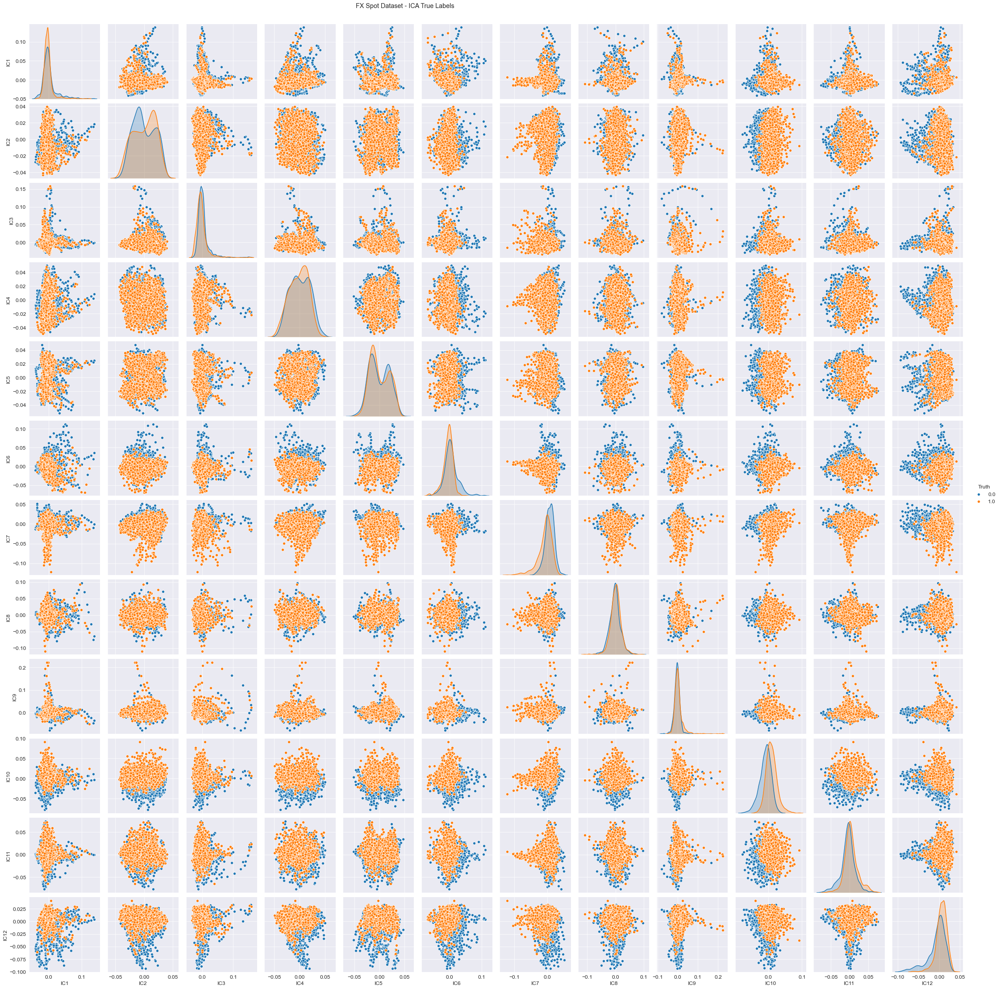

In [468]:
#TRUTH LABELS USING ICA
TRUTH_LABELS_ICA = pd.DataFrame(S_,columns=['IC1','IC2','IC3','IC4','IC5','IC6','IC7','IC8','IC9','IC10','IC11','IC12'])
TRUTH_LABELS_ICA['Truth'] = y_train
g = sns.pairplot(TRUTH_LABELS_ICA, hue="Truth", diag_kind= 'kde')
g.fig.suptitle("FX Spot Dataset - ICA True Labels", x=0.4, y=1.02)

In [469]:
#Cluster Performance Scores PCA_KM
print(v_measure_score(y_train,clusters_ICA_KM))
print(homogeneity_score(y_train,clusters_ICA_KM))
print(completeness_score(y_train,clusters_ICA_KM))
print(adjusted_rand_score(y_train,clusters_ICA_KM))
print(fowlkes_mallows_score(y_train,clusters_ICA_KM))

0.007447427709426248
0.014815722233079382
0.004973807110937729
0.002638906364795162
0.2651465354963758


#### EM Clustering with ICA

In [493]:
#Silhouette coefficient
n_clusters=np.arange(2, 16)
sils=[]
sils_err=[]
iterations=20
for n in n_clusters:
    tmp_sil=[]
    for _ in range(iterations):
        gmm=GaussianMixture(n, n_init=2).fit(S_) 
        labels=gmm.predict(S_)
        sil=metrics.silhouette_score(S_, labels, metric='euclidean')
        tmp_sil.append(sil)
    val=np.mean(SelBest(np.array(tmp_sil), int(iterations/5)))
    err=np.std(tmp_sil)
    sils.append(val)
    sils_err.append(err)

Text(0, 0.5, 'Silhouette Score')

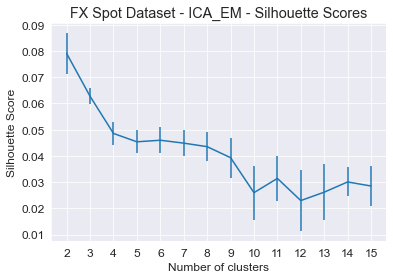

In [494]:
plt.errorbar(n_clusters, sils, yerr=sils_err)
plt.title("FX Spot Dataset - ICA_EM - Silhouette Scores")
plt.xticks(n_clusters)
plt.xlabel("Number of clusters")
plt.ylabel("Silhouette Score")
#Siluhoette score the highe rthe better so we pick 2, but we could also pick 3 cus we dont want a lot of variance

In [495]:
#Distance between train and test GMMs
n_clusters=np.arange(2, 16)
iterations=20
results=[]
res_sigs=[]
for n in n_clusters:
    dist=[]
    
    for iteration in range(iterations):
        train, test=train_test_split(S_, test_size=0.5)
        
        gmm_train=GaussianMixture(n, n_init=2).fit(train) 
        gmm_test=GaussianMixture(n, n_init=2).fit(test) 
        dist.append(gmm_js(gmm_train, gmm_test))
    selec=SelBest(np.array(dist), int(iterations/5))
    result=np.mean(selec)
    res_sig=np.std(selec)
    results.append(result)
    res_sigs.append(res_sig)

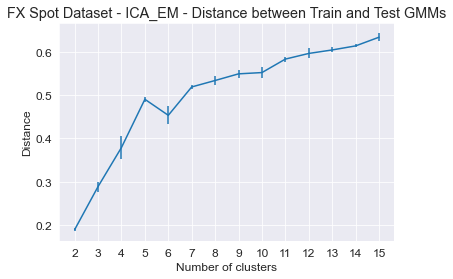

In [496]:
plt.errorbar(n_clusters, results, yerr=res_sigs)
plt.title("FX Spot Dataset - ICA_EM - Distance between Train and Test GMMs")
plt.xticks(n_clusters)
plt.xlabel("Number of clusters")
plt.ylabel("Distance")
plt.show()

We can say that the good configuration, which takes in account both of the amount of information included (=biggest possible number of clusters) and on the stability of the fitting procedure (=lowest possible GMMs distance), is the one which considers <b>k=TWO cluster.

In [497]:
# BIC
n_clusters=np.arange(2, 16)
bics=[]
bics_err=[]
iterations=20
for n in n_clusters:
    tmp_bic=[]
    for _ in range(iterations):
        gmm=GaussianMixture(n, n_init=2).fit(S_) 
        
        tmp_bic.append(gmm.bic(S_))
    val=np.mean(SelBest(np.array(tmp_bic), int(iterations/5)))
    err=np.std(tmp_bic)
    bics.append(val)
    bics_err.append(err)

Text(0, 0.5, 'BIC Score')

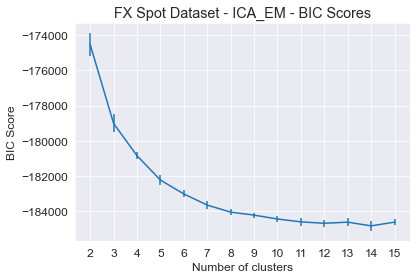

In [498]:
plt.errorbar(n_clusters,bics, yerr=bics_err, label='BIC')
plt.title("FX Spot Dataset - ICA_EM - BIC Scores")
plt.xticks(n_clusters)
plt.xlabel("Number of clusters")
plt.ylabel("BIC Score")

In [502]:
# BIC the higher the better so we also pick k=2

In [503]:
#Lets create our EM with 12 ICA components based on the results we obtained above
ICA_EM =GaussianMixture(2, n_init=2).fit(S_) #Fit our EM model with 2 clusters, feeding the Indep Components as our X
clusters_ICA_EM = ICA_EM.predict(S_) # generate cluster assignmant based on our data and the two clusters
clusters_ICA_EM_prob = ICA_EM.predict_proba(S_) #generate probability of cluster assignmnet

In [504]:
#Idea is to find the max prob of each row and average them. A value close to 1 will mean that the clustering is good because
# the algorithm is quite confident that a datapoint will belong to a specific cluster. On the other hand, an average prob
# value of 0.5 is quite poor because it means the algo is only slightly better than chance in terms of its confidence.

# axis=1 to find max from each row
np.amax(clusters_ICA_EM_prob, axis=1).mean()
#This is a GOOD value! :) Now lets look at the cluster PMs

0.980120783468674

In [505]:
#Cluster Performance Scores ICA_EM
print(v_measure_score(y_train,clusters_ICA_EM))
print(homogeneity_score(y_train,clusters_ICA_EM))
print(completeness_score(y_train,clusters_ICA_EM))
print(adjusted_rand_score(y_train,clusters_ICA_EM))
print(fowlkes_mallows_score(y_train,clusters_ICA_EM))

0.0008020449172733716
0.0008012253662066315
0.0008028661466486356
0.0007548658254576401
0.5009088258530422


Text(0.4, 1.02, 'FX Spot Dataset - ICA_EM Clustering')

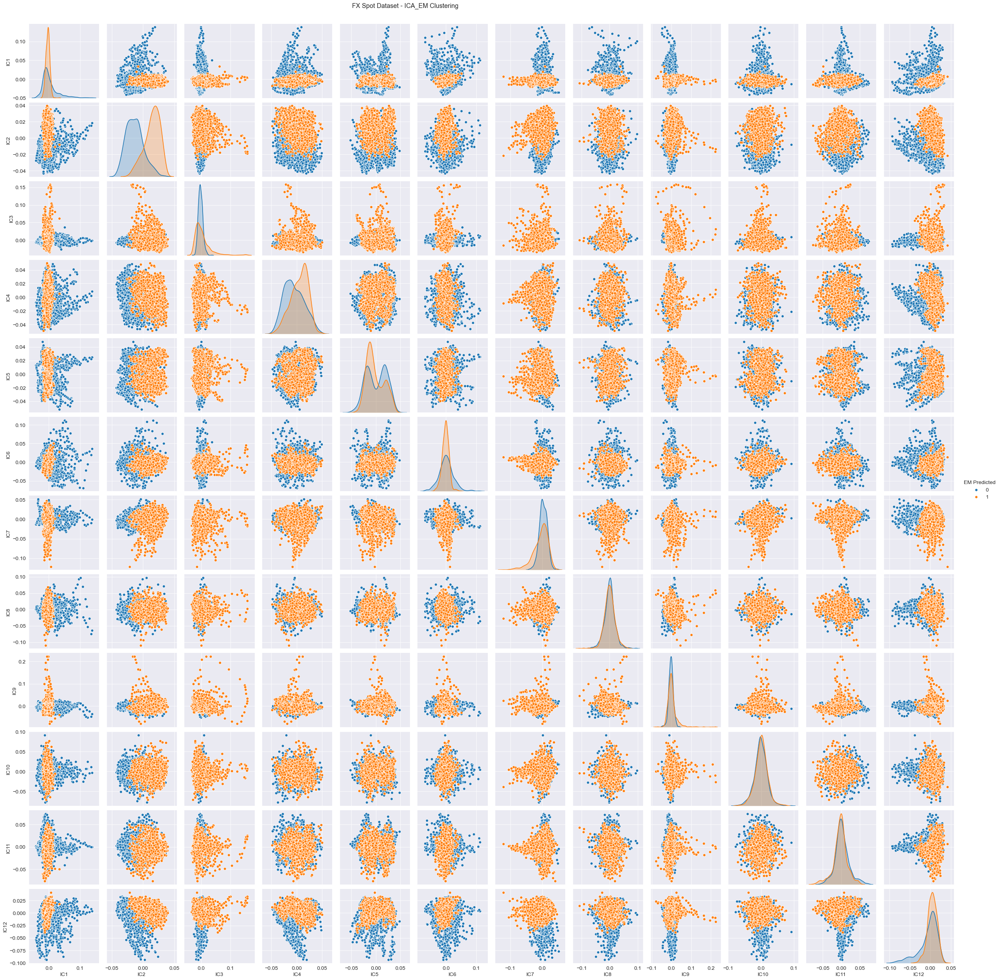

In [506]:
#Visualize Cluster distribution based on ICA
#Print out diagonal labels based on K= optimal k
TWELVE_ICs_EM = pd.DataFrame(S_,columns=['IC1','IC2','IC3','IC4','IC5','IC6','IC7','IC8','IC9','IC10','IC11','IC12'])
gmm = GaussianMixture(2, n_init=2).fit(np.array(TWELVE_ICs_EM)) 
TWELVE_ICs_EM['EM Predicted'] = clusters_ICA_EM
g = sns.pairplot(TWELVE_ICs_EM, hue="EM Predicted", diag_kind= 'kde')
g.fig.suptitle("FX Spot Dataset - ICA_EM Clustering", x=0.4, y=1.02)

# RANDOMIZED PROJECTION
#### Gaussian  Projection

In [94]:
# Gaussian Random Projection
from sklearn.random_projection import GaussianRandomProjection

projector = GaussianRandomProjection(n_components=2,eps=0.05)
X_new = projector.fit_transform(X)

0


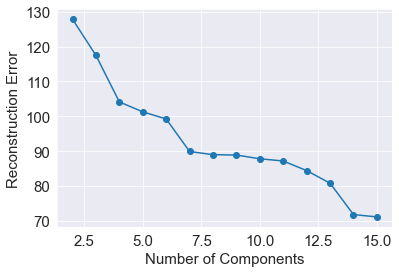

1


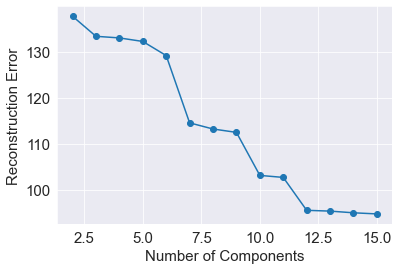

2


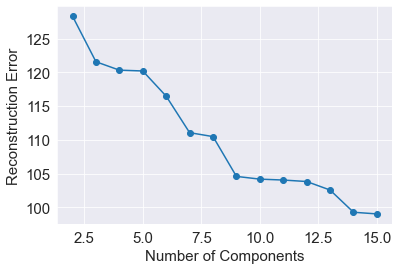

3


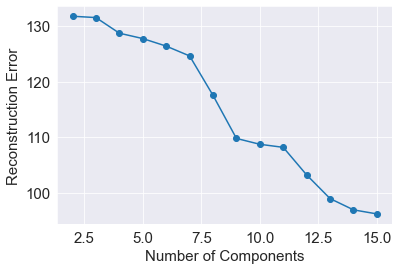

4


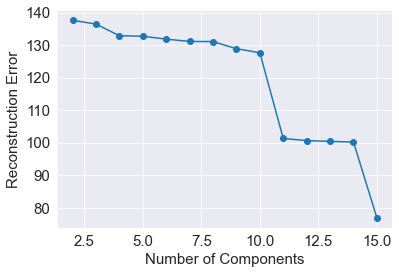

5


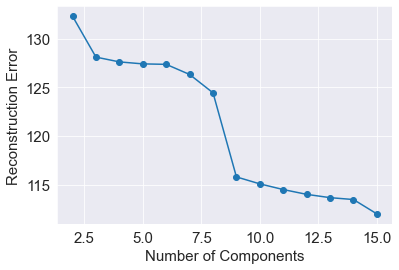

6


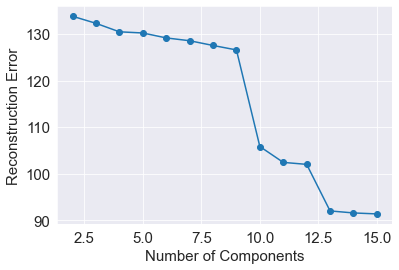

7


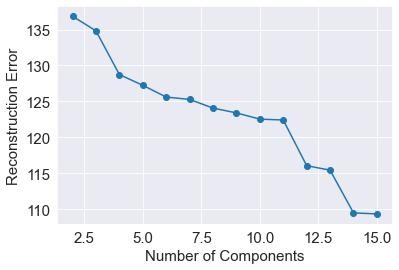

8


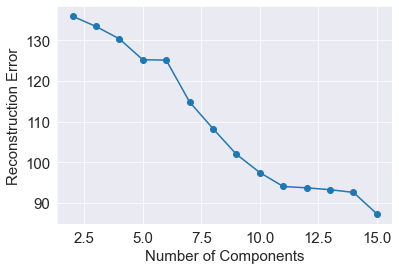

9


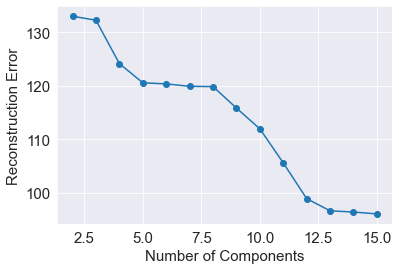

10


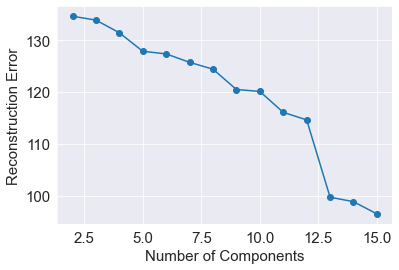

11


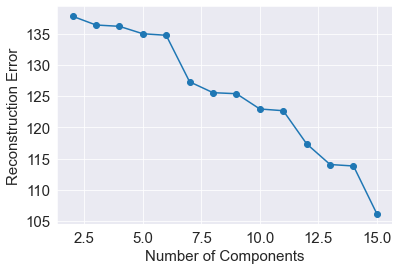

12


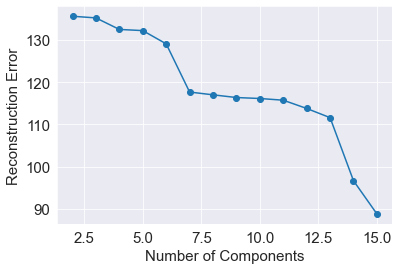

13


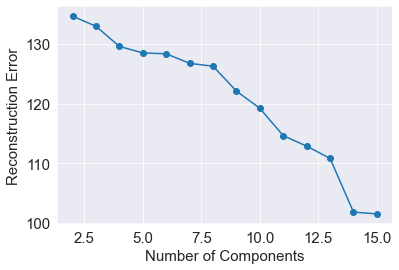

14


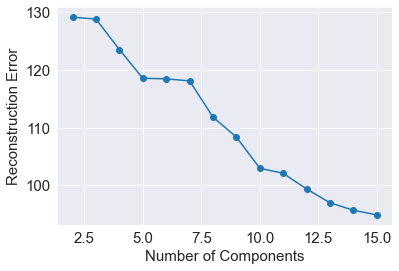

15


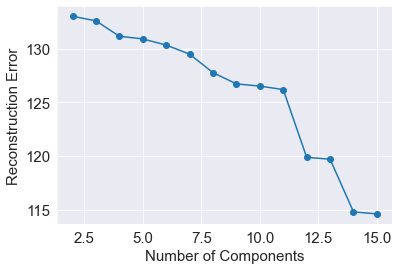

16


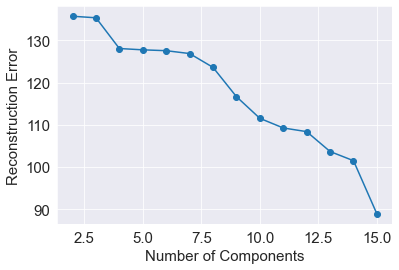

17


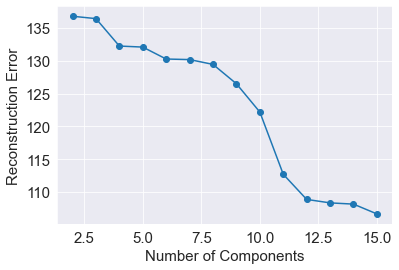

18


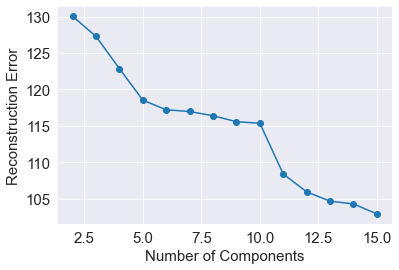

19


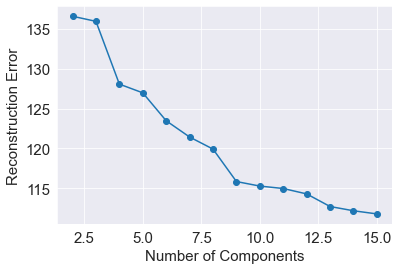

20


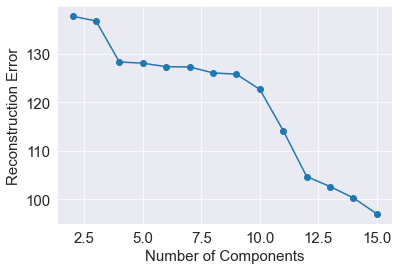

21


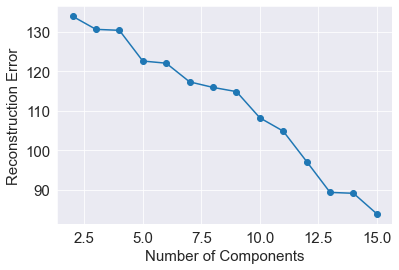

22


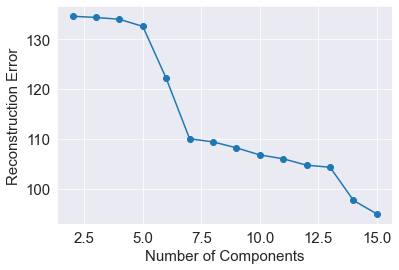

23


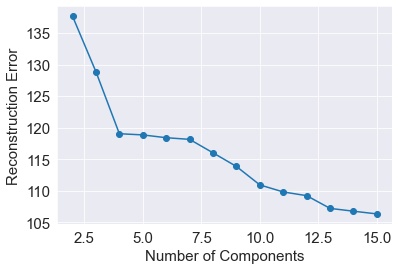

24


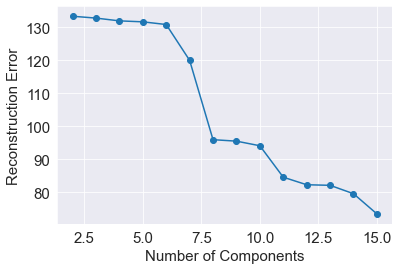

25


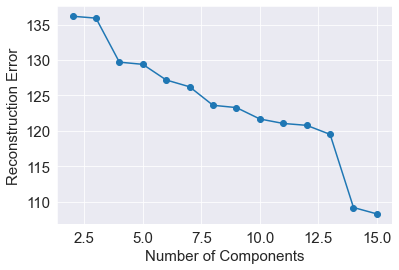

26


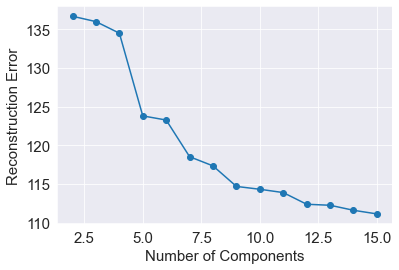

27


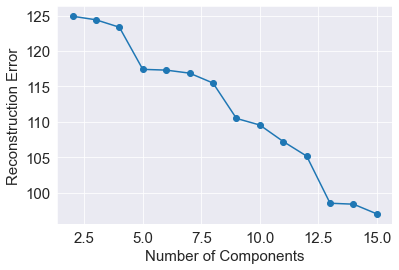

28


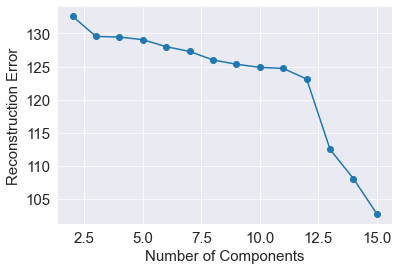

29


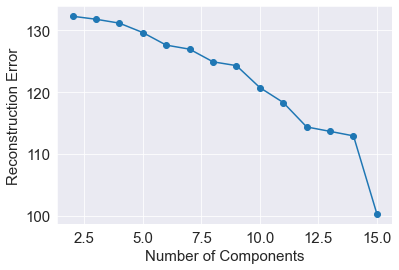

30


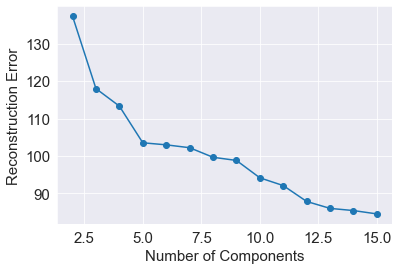

31


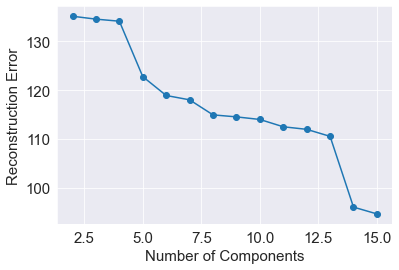

32


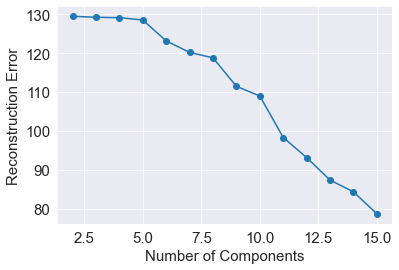

33


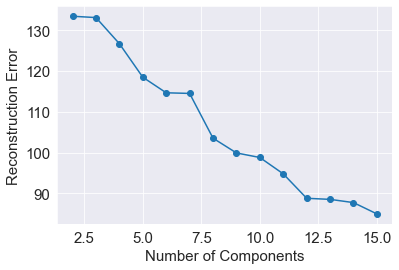

34


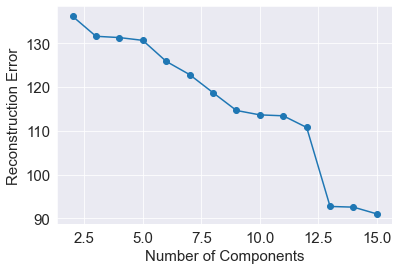

35


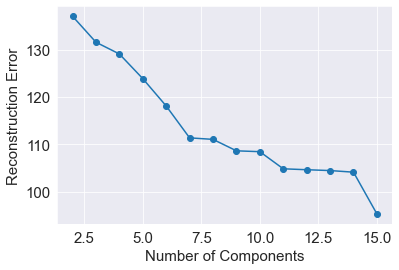

36


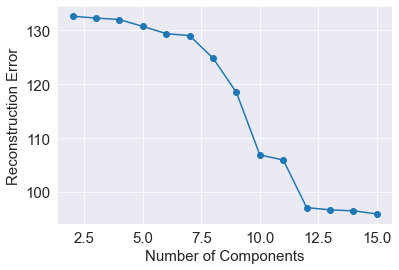

37


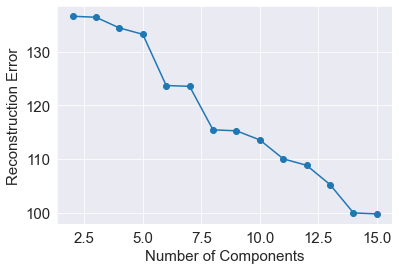

38


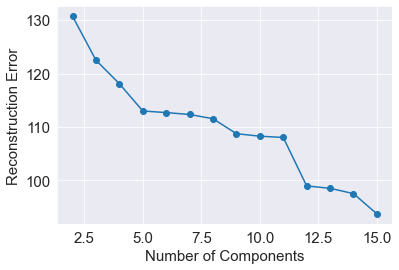

39


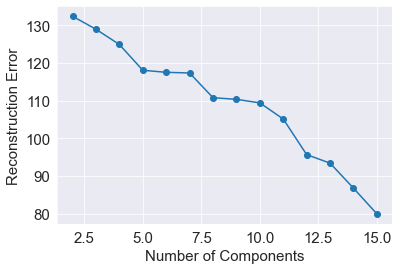

40


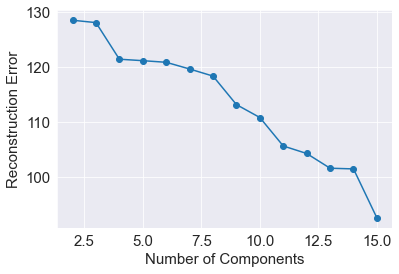

41


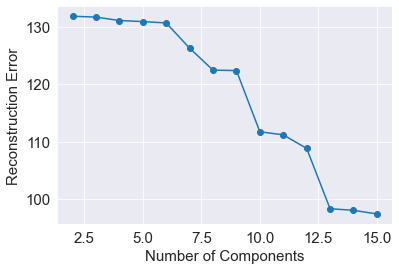

42


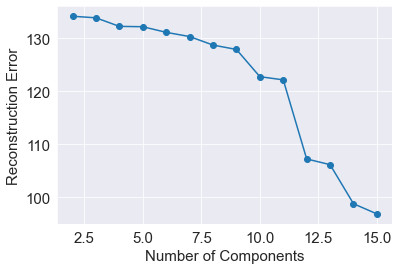

43


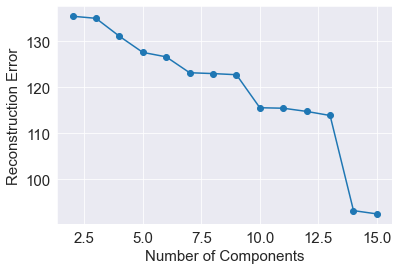

44


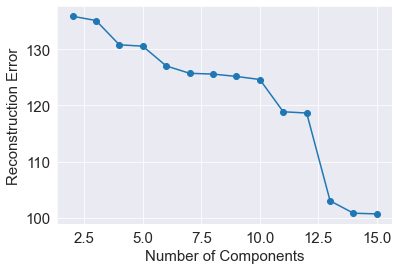

45


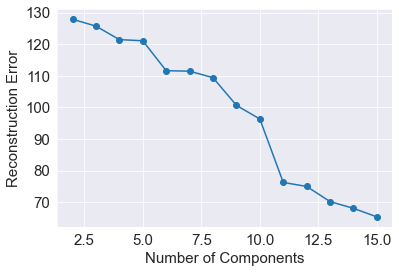

46


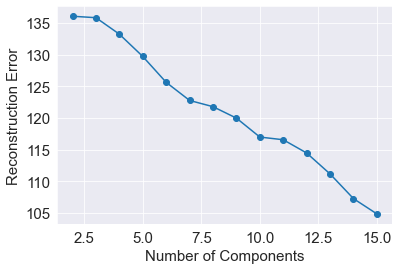

47


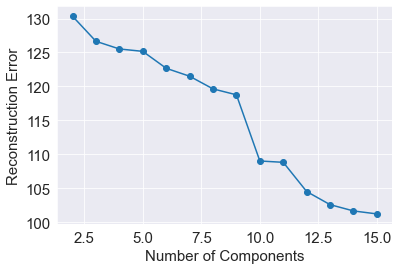

48


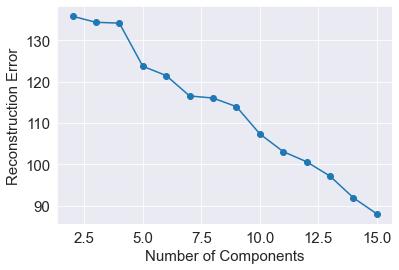

49


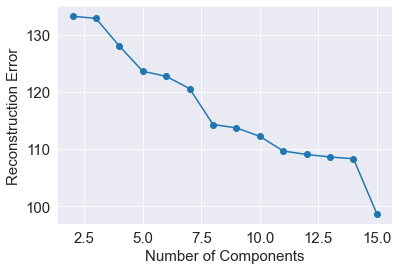

In [95]:
#Reconstruction error w/ multiple random_states
for j in range(50):
    RECONSTRUCTION_ERRORS = []
    print(j)
    for i in range(2,16):
        #RP
        A=X
        transformer = GaussianRandomProjection(n_components=i, eps=0.05, random_state=j)
        Y = transformer.fit_transform(X)
        W=transformer.components_

        #numpy pinv
        W_pinv=np.linalg.pinv(W).transpose()
        B = np.dot(Y, W_pinv)

        #calc. dist. from original points
        dist = np.linalg.norm(A-B)
        RECONSTRUCTION_ERRORS.append(dist)
        
    #Plot
    plt.plot(list(range(2,16)), RECONSTRUCTION_ERRORS, marker='o')
    plt.xlabel('Number of Components')
    plt.ylabel('Reconstruction Error')
    plt.show()

In [476]:
R_SQUARED

[-13.6554,
 -14.1644,
 -14.1797,
 -14.1936,
 -14.639,
 -11.9726,
 -6.0233,
 -6.2485,
 -6.1301,
 -5.6431,
 -5.4423,
 -5.3854,
 -5.1696,
 -4.4992]

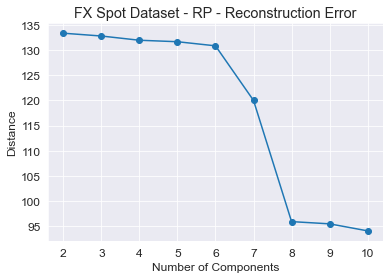

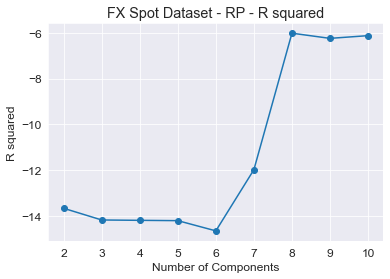

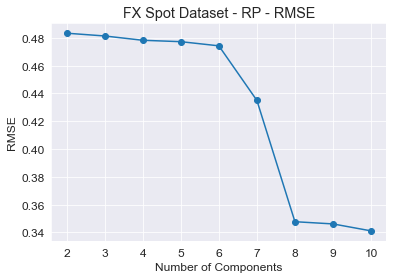

In [480]:
DISTANCES = []
R_SQUARED = []
RMSEs = []

for i in range(2,11):
    #RP
    rp = GaussianRandomProjection(n_components=i, eps=0.05, random_state=24)
    X_new = rp.fit_transform(X)
    Random_Matrix = rp.components_

    #numpy pinv
    W_pinv = np.linalg.pinv(Random_Matrix).T
    Reconstructed = np.dot(X_new, W_pinv)

    #calc. dist. from original points ( X(original features) - Reconstructed )
    dist = np.linalg.norm(X - Reconstructed)
    DISTANCES.append(dist)
    
    #append r squared
    r2 = round(r2_score(X, Reconstructed),4)
    R_SQUARED.append(r2)
    
    #append rmse
    rmse = round(np.sqrt(mean_squared_error(X, Reconstructed)),4)
    RMSEs.append(rmse)

plt.plot(list(range(2,11)), DISTANCES, marker='o')
plt.xlabel('Number of Components')
plt.ylabel('Distance')
plt.title('FX Spot Dataset - RP - Reconstruction Error')
plt.show()

plt.plot(list(range(2,11)), R_SQUARED, marker='o')
plt.xlabel('Number of Components')
plt.ylabel('R squared')
plt.title('FX Spot Dataset - RP - R squared')
plt.show()

plt.plot(list(range(2,11)), RMSEs, marker='o')
plt.xlabel('Number of Components')
plt.ylabel('RMSE')
plt.title('FX Spot Dataset - RP - RMSE')
plt.show()

In [97]:
#We pick 8 as the number of components becaus eth whole idea is that we want to reduce the number of features. So 
# eventhough we get a lower reconstruction error with 10, we are happy with the drop in reconstruction error that we obtain 
# from n=7 to n=8 (similar to the elbow method), so we decide to pick 8 as our n of comps.

In [484]:
#Build our RP with 8 n_components
transformer = GaussianRandomProjection(n_components=8, eps=0.05, random_state=24)
X_new = transformer.fit_transform(X)

#### KM with RP

In [487]:
#Obtain the inertia, silhuoette and DB index, by feeding in the 12 ICA Components
inertia = []
sse, db, slc = {}, {}, {}

for k in range(2,11):
    
    #Create KM model instance
    kmeans = KMeans(
        n_clusters=k, init="k-means++",
        n_init=10,
        tol=1e-04, random_state=42)
    
    
    # Fit model to samples
    #We are only using 8 Components. 
    FIT = kmeans.fit(X_new)
    inertia.append(kmeans.inertia_)
    clusters = FIT.labels_
    sse[k] = FIT.inertia_
    db[k] = davies_bouldin_score(X_new, clusters)
    slc[k] = silhouette_score(X_new, clusters)

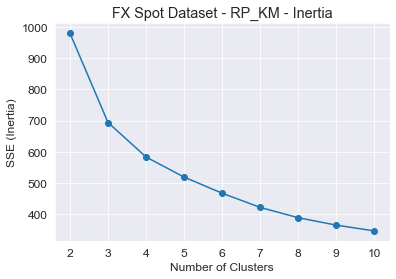

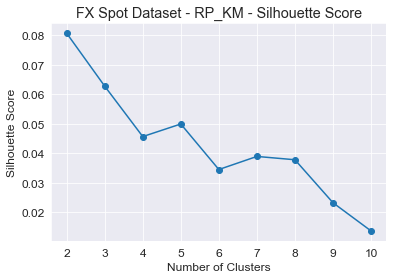

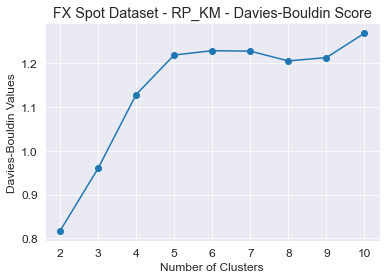

In [514]:
### Elbow Method

sns.set_style("darkgrid")
plt.plot(list(sse.keys()), list(sse.values()), marker='o')
plt.xlabel('Number of Clusters')
plt.ylabel('SSE (Inertia)')
plt.title('FX Spot Dataset - RP_KM - Inertia')
plt.show()
# 4 Seems to be the best k value according to Elbow method

### Silhouette Analysis

plt.plot(list(slc.keys()), list(slc.values()), marker='o')
plt.xlabel('Number of Clusters')
plt.ylabel('Silhouette Score')
plt.title('FX Spot Dataset - RP_KM - Silhouette Score')
plt.show()
#For Sillhouette Score the higher the better. It seems like 2 is the best k accoring to sillhouette

### Davies-Bouldin Index

plt.plot(list(db.keys()), list(db.values()), marker='o')
plt.xlabel('Number of Clusters')
plt.ylabel('Davies-Bouldin Values')
plt.title('FX Spot Dataset - RP_KM - Davies-Bouldin Score')
plt.show()
# For DB Index the lower the better so k=2 seems to be the best value here.

Text(0.4, 1.02, 'FX Spot Dataset - RP_KM Clustering')

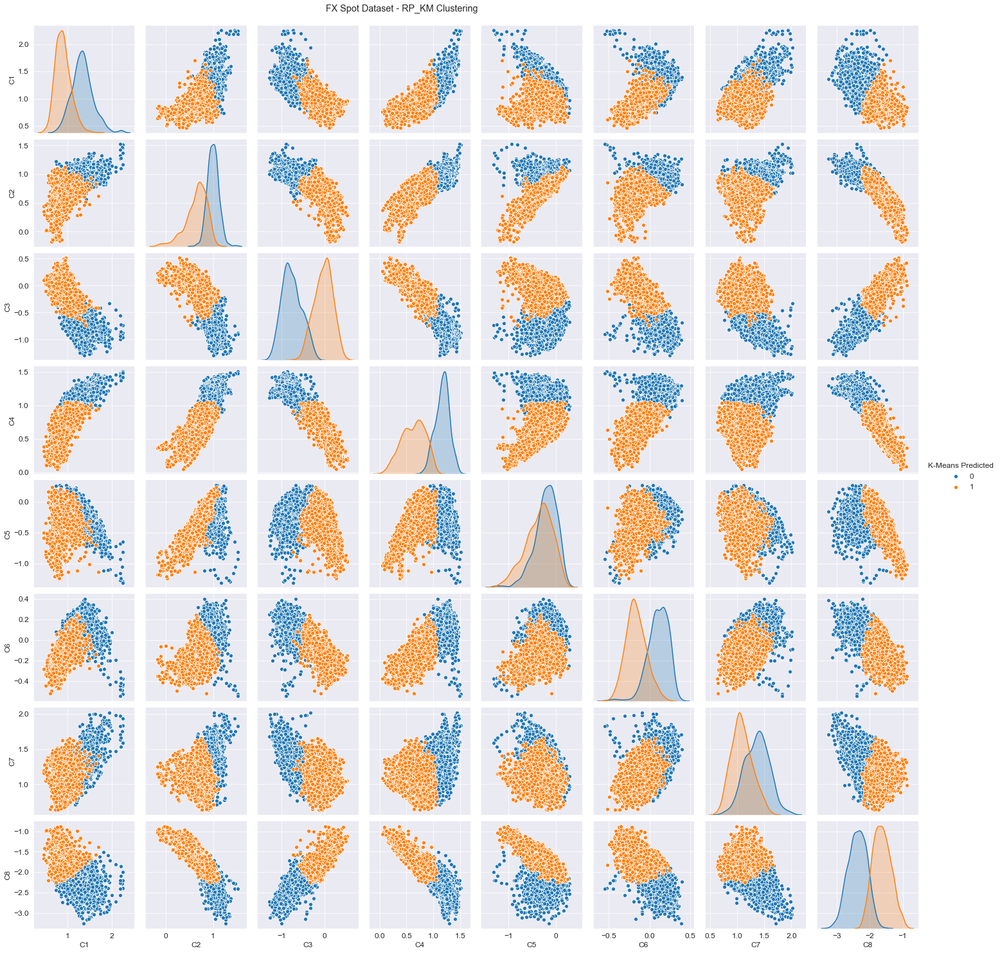

In [490]:
# We pick 2 as the optimal number of clusters for RP_KM, using 8 as number of RP components

#Visualize Cluster distribution based on RP
EIGHT_Cs = pd.DataFrame(X_new,columns=['C1','C2','C3','C4','C5','C6','C7','C8'])
kmeans = KMeans(n_clusters = 2, init = 'k-means++',random_state=1).fit(np.array(EIGHT_Cs))
clusters_RP_KM = kmeans.labels_
EIGHT_Cs['K-Means Predicted'] = clusters_RP_KM
g = sns.pairplot(EIGHT_Cs, hue="K-Means Predicted", diag_kind= 'kde')
g.fig.suptitle("FX Spot Dataset - RP_KM Clustering", x=0.4, y=1.02)

Text(0.4, 1.02, 'FX Spot Dataset - RP True Labels')

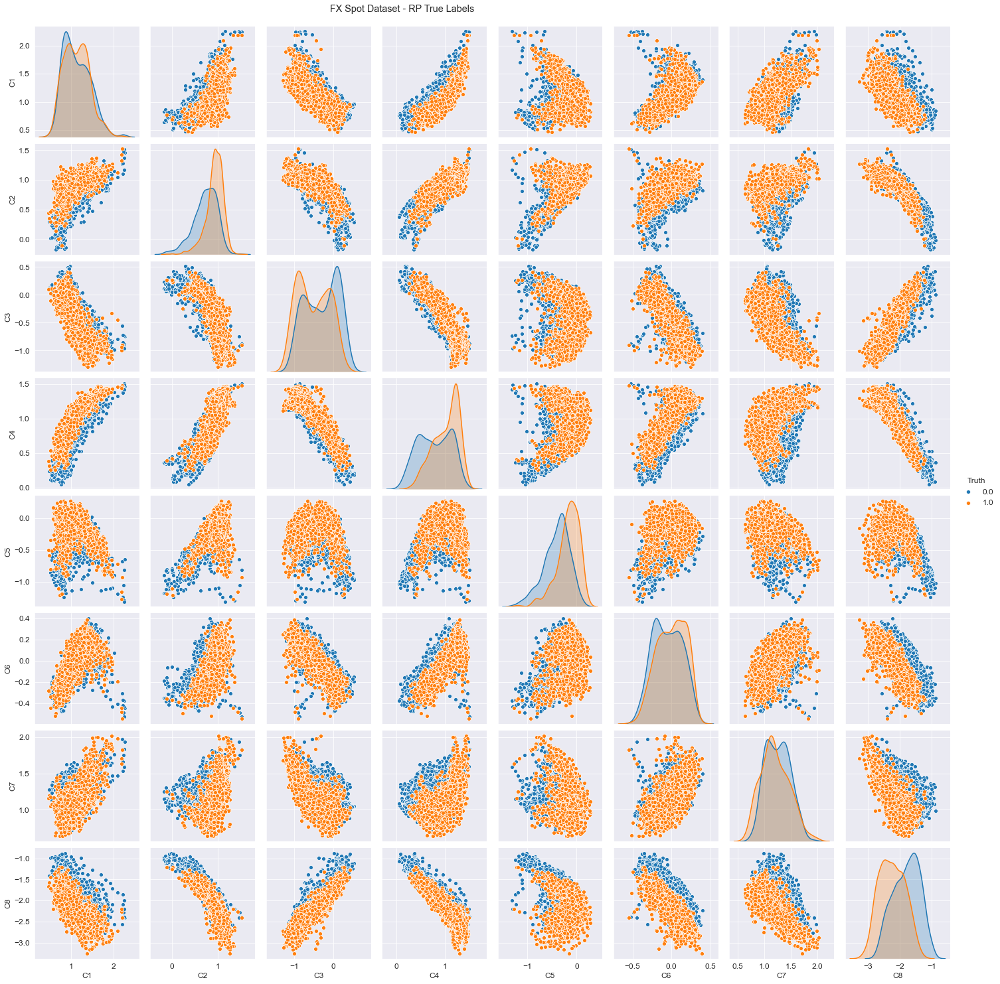

In [491]:
#TRUTH LABELS USING RP
TRUTH_LABELS_RP = pd.DataFrame(X_new,columns=['C1','C2','C3','C4','C5','C6','C7','C8'])
TRUTH_LABELS_RP['Truth'] = y_train
g = sns.pairplot(TRUTH_LABELS_RP, hue="Truth", diag_kind= 'kde')
g.fig.suptitle("FX Spot Dataset - RP True Labels", x=0.4, y=1.02)

In [492]:
#Cluster Performance Scores RP_KM
print(v_measure_score(y_train,clusters_RP_KM))
print(homogeneity_score(y_train,clusters_RP_KM))
print(completeness_score(y_train,clusters_RP_KM))
print(adjusted_rand_score(y_train,clusters_RP_KM))
print(fowlkes_mallows_score(y_train,clusters_RP_KM))

0.001123095999502932
0.0011230011750508707
0.0011231908399700005
0.0011832571940175662
0.5004744098817366


#### EM Clustering with RP

In [507]:
#Silhouette coefficient
n_clusters=np.arange(2, 16)
sils=[]
sils_err=[]
iterations=20
for n in n_clusters:
    tmp_sil=[]
    for _ in range(iterations):
        gmm=GaussianMixture(n, n_init=2).fit(X_new) 
        labels=gmm.predict(X_new)
        sil=metrics.silhouette_score(X_new, labels, metric='euclidean')
        tmp_sil.append(sil)
    val=np.mean(SelBest(np.array(tmp_sil), int(iterations/5)))
    err=np.std(tmp_sil)
    sils.append(val)
    sils_err.append(err)

Text(0, 0.5, 'Silhouette Score')

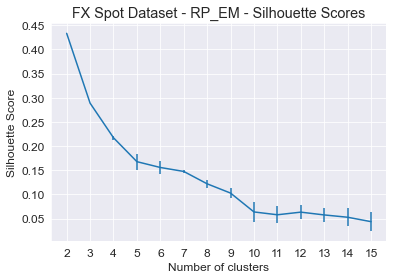

In [509]:
plt.errorbar(n_clusters, sils, yerr=sils_err)
plt.title("FX Spot Dataset - RP_EM - Silhouette Scores")
plt.xticks(n_clusters)
plt.xlabel("Number of clusters")
plt.ylabel("Silhouette Score")

In [510]:
#Distance between train and test GMMs
n_clusters=np.arange(2, 16)
iterations=20
results=[]
res_sigs=[]
for n in n_clusters:
    dist=[]
    
    for iteration in range(iterations):
        train, test=train_test_split(X_new, test_size=0.5)
        
        gmm_train=GaussianMixture(n, n_init=2).fit(train) 
        gmm_test=GaussianMixture(n, n_init=2).fit(test) 
        dist.append(gmm_js(gmm_train, gmm_test))
    selec=SelBest(np.array(dist), int(iterations/5))
    result=np.mean(selec)
    res_sig=np.std(selec)
    results.append(result)
    res_sigs.append(res_sig)

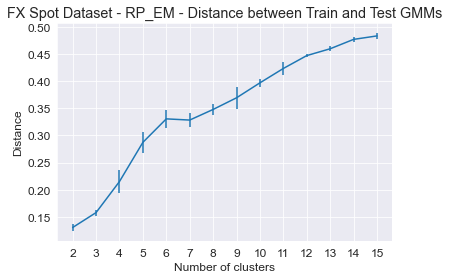

In [511]:
plt.errorbar(n_clusters, results, yerr=res_sigs)
plt.title("FX Spot Dataset - RP_EM - Distance between Train and Test GMMs")
plt.xticks(n_clusters)
plt.xlabel("Number of clusters")
plt.ylabel("Distance")
plt.show()

In [512]:
# BIC
n_clusters=np.arange(2, 16)
bics=[]
bics_err=[]
iterations=20
for n in n_clusters:
    tmp_bic=[]
    for _ in range(iterations):
        gmm=GaussianMixture(n, n_init=2).fit(X_new) 
        
        tmp_bic.append(gmm.bic(X_new))
    val=np.mean(SelBest(np.array(tmp_bic), int(iterations/5)))
    err=np.std(tmp_bic)
    bics.append(val)
    bics_err.append(err)

Text(0, 0.5, 'BIC Score')

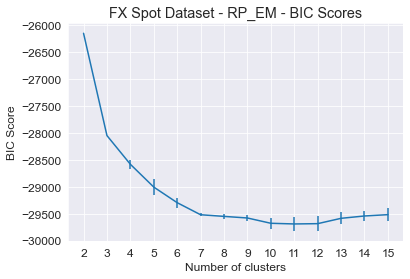

In [513]:
plt.errorbar(n_clusters,bics, yerr=bics_err, label='BIC')
plt.title("FX Spot Dataset - RP_EM - BIC Scores")
plt.xticks(n_clusters)
plt.xlabel("Number of clusters")
plt.ylabel("BIC Score")

In [517]:
#Lets create our EM with 5 n \clusters based on the results we obtained above
RP_EM =GaussianMixture(4, n_init=2).fit(X_new) #Fit our EM model with 5 clusters, feeding the RP Components as our X
clusters_RP_EM = RP_EM.predict(X_new) # generate cluster assignmant based on our data and the five clusters
clusters_RP_EM_prob = RP_EM.predict_proba(X_new) #generate probability of cluster assignmnet

In [518]:
#Idea is to find the max prob of each row and average them. A value close to 1 will mean that the clustering is good because
# the algorithm is quite confident that a datapoint will belong to a specific cluster. On the other hand, an average prob
# value of 0.5 is quite poor because it means the algo is only slightly better than chance in terms of its confidence.

# axis=1 to find max from each row
np.amax(clusters_RP_EM_prob, axis=1).mean()
#This is a GOOD value! :) Now lets look at the cluster PMs

0.8966223276369587

In [519]:
#Cluster Performance Scores RP_KM
print(v_measure_score(y_train,clusters_RP_EM))
print(homogeneity_score(y_train,clusters_RP_EM))
print(completeness_score(y_train,clusters_RP_EM))
print(adjusted_rand_score(y_train,clusters_RP_EM))
print(fowlkes_mallows_score(y_train,clusters_RP_EM))

0.006010987536887776
0.008788934161910527
0.00456736562630194
0.004633808077886603
0.3745640940589045


Text(0.4, 1.02, 'FX Spot Dataset - RP_EM Clustering')

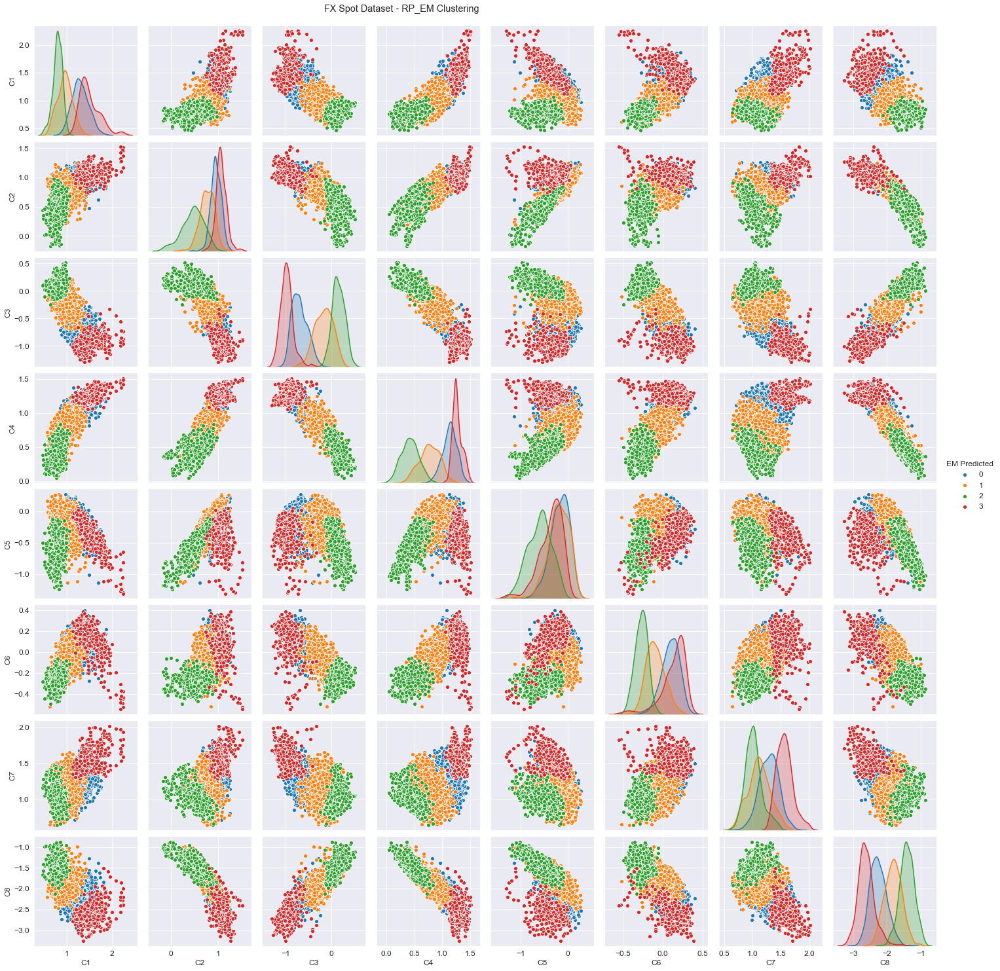

In [520]:
#Visualize Cluster distribution based on RP
#Print out diagonal labels based on K= 5(optimal )
EIGHT_Cs_EM = pd.DataFrame(X_new,columns=['C1','C2','C3','C4','C5','C6','C7','C8'])
gmm = GaussianMixture(5, n_init=2).fit(np.array(EIGHT_Cs_EM)) 
EIGHT_Cs_EM['EM Predicted'] = clusters_RP_EM
g = sns.pairplot(EIGHT_Cs_EM, hue="EM Predicted", diag_kind= 'kde')
g.fig.suptitle("FX Spot Dataset - RP_EM Clustering", x=0.4, y=1.02)

# END OF RP!

# Decide N Clusters for RP_KM, Plot RP_KM and print PMs
# Do ALL RP_EM

# Do FS_KM
# Do FS_EM

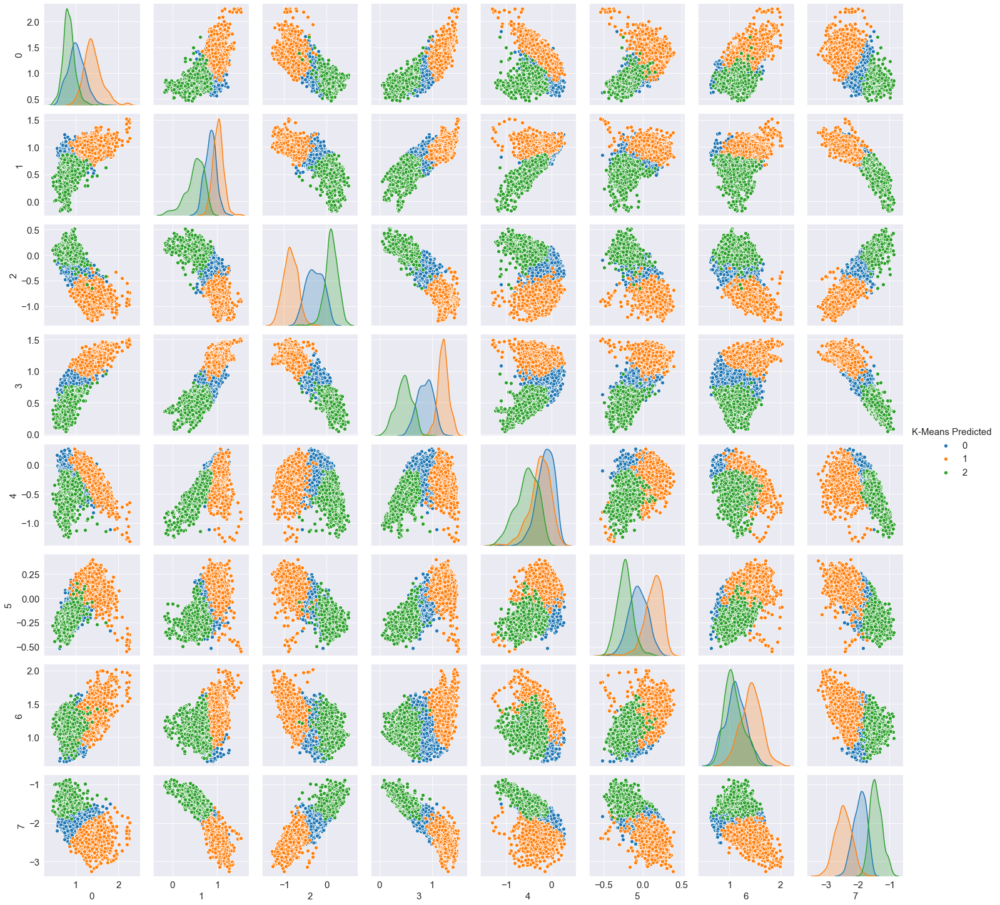

In [100]:
#Visualize Cluster distribution based on RP
#Print out diagonal labels based on K= optimal k
THREE_RP_Comps = pd.DataFrame(Y)
kmeans = KMeans(n_clusters = 3, init = 'k-means++',random_state=1).fit(Y)
clusters = kmeans.labels_
THREE_RP_Comps['K-Means Predicted'] = clusters
sns.pairplot(THREE_RP_Comps, hue="K-Means Predicted", diag_kind= 'kde')

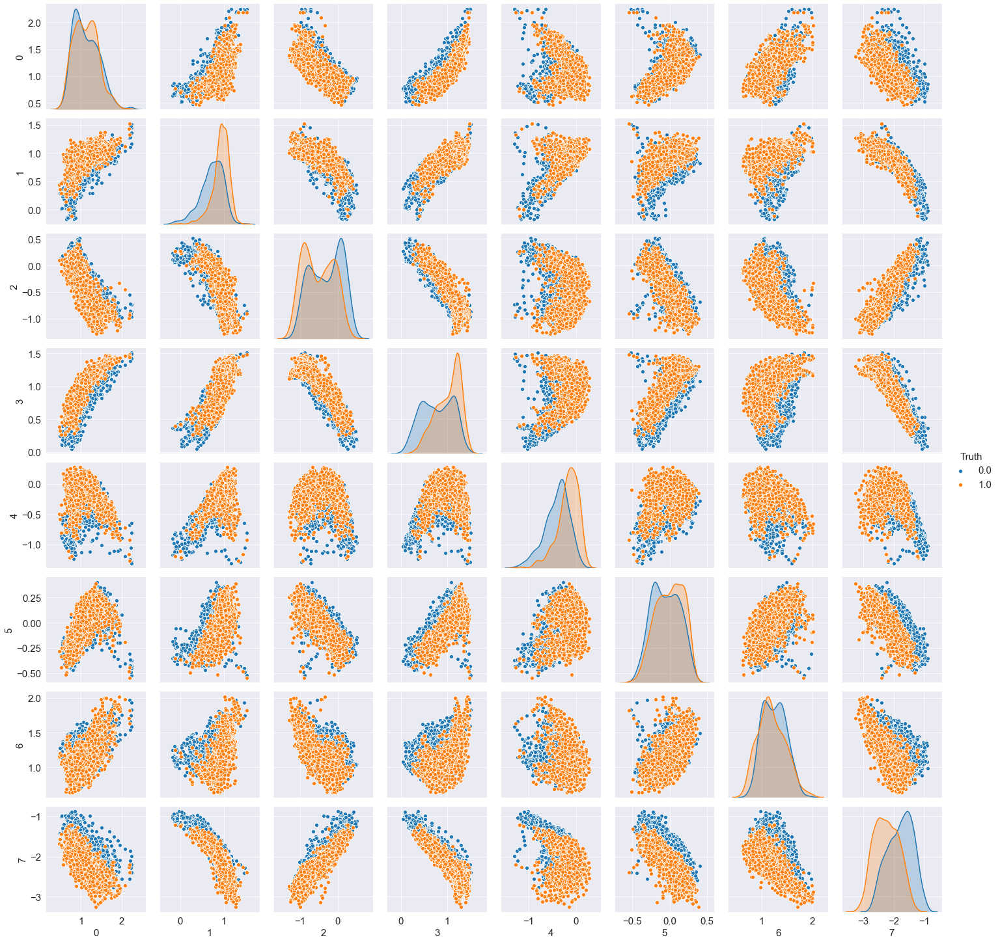

In [101]:
THREE_RP_Comps['Truth'] = y_train
sns.pairplot(THREE_RP_Comps[[0,1,2,3,4,5,6,7,'Truth']], hue="Truth", diag_kind= 'kde')

To further evaluate clustering performance we can use: \
<b>(i)Extrinsic Measures<b>  \
which require ground truth labels. Examples are Adjusted Rand index, Fowlkes-Mallows scores, Mutual information based scores, Homogeneity, Completeness and V-measure. \
    
<b> (ii) Intrinsic Measures <b> \
    that does not require ground truth labels. Some of the clustering performance measures are Silhouette Coefficient, Calinski-Harabasz Index, Davies-Bouldin Index etc.


# Quadratic Discriminant Analysis (QDA)

In [102]:
from sklearn.discriminant_analysis import QuadraticDiscriminantAnalysis, LinearDiscriminantAnalysis
clf = QuadraticDiscriminantAnalysis()
clf.fit(X, y_train)

C:\Users\andyg\Miniconda3\envs\ML\lib\site-packages\sklearn\discriminant_analysis.py:715: UserWarning:

Variables are collinear



QuadraticDiscriminantAnalysis()

# FEATURE SELECTION - Sequential Feature Selection
### Forward FS, Forward Floating FS, Backward FS, Backward Floating FS

In [103]:
from mlxtend.feature_selection import SequentialFeatureSelector as SFS
from sklearn.neighbors import KNeighborsClassifier
from sklearn.svm import SVC

In [104]:
#Define our CV type = TimeSeriesSplit CV
Number_of_Splits = 5
CV_time_split = TimeSeriesSplit(n_splits= Number_of_Splits)

In [105]:
#Define our Evaluation metric (Fbeta with beta=0.5, because we care more about Precision than Recall)
fO5_scorer = make_scorer(fbeta_score, beta=0.5)

##### KNN as classifier

In [106]:
knn = KNeighborsClassifier(n_neighbors=4)

In [129]:
sfs1 = SFS(knn, 
           k_features = 27, 
           forward = True, 
           floating = False, 
           verbose = 2,
           scoring = fO5_scorer,
           cv= CV_time_split)

sfs1 = sfs1.fit(X, y_train, custom_feature_names=list(Feature_Names))

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  28 out of  28 | elapsed:    1.9s finished

[2022-03-21 06:30:33] Features: 1/27 -- score: 0.6119179592606392[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  27 out of  27 | elapsed:    1.7s finished

[2022-03-21 06:30:35] Features: 2/27 -- score: 0.7403717338074767[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  26 out of  26 | elapsed:    1.8s finished

[2022-03-21 06:30:37] Features: 3/27 -- score: 0.7860422519716014[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done  

In [109]:
sfs1.k_score_

0.7278794611524411

In [110]:
#Via the subsets_ attribute (dict), we can take a look at the selected feature indices at each step:
sfs1.subsets_

{1: {'feature_idx': (23,),
  'cv_scores': array([0.60838446, 0.68452381, 0.6027668 , 0.59265442, 0.57126031]),
  'avg_score': 0.6119179592606392,
  'feature_names': ('VE_Lower Band',)},
 2: {'feature_idx': (18, 23),
  'cv_scores': array([0.73786408, 0.75539568, 0.78846154, 0.6181998 , 0.80193757]),
  'avg_score': 0.7403717338074767,
  'feature_names': ('%B ', 'VE_Lower Band')},
 3: {'feature_idx': (17, 18, 23),
  'cv_scores': array([0.74614065, 0.79198473, 0.85056391, 0.74421169, 0.79731028]),
  'avg_score': 0.7860422519716014,
  'feature_names': ('BollW (EURUSD BGN)', '%B ', 'VE_Lower Band')},
 4: {'feature_idx': (17, 18, 22, 23),
  'cv_scores': array([0.74620573, 0.82843137, 0.84090909, 0.75291622, 0.82074522]),
  'avg_score': 0.7978415276692642,
  'feature_names': ('BollW (EURUSD BGN)',
   '%B ',
   'VE_Upper Band',
   'VE_Lower Band')},
 5: {'feature_idx': (2, 17, 18, 22, 23),
  'cv_scores': array([0.77370304, 0.83498024, 0.86574074, 0.71805702, 0.83247688]),
  'avg_score': 0.80499

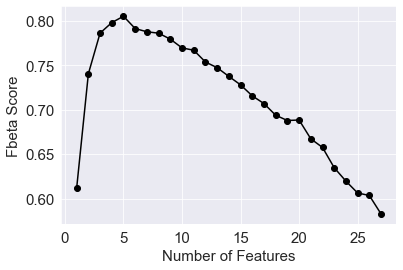

In [130]:
SCORES=[]
for i in range(1,28):
    SCORES.append(sfs1.subsets_[i]['avg_score'])
    
plt.plot(list(range(1,28)), SCORES, '-o', color='black')
plt.xlabel('Number of Features')
plt.ylabel('Fbeta Score')
plt.show()

In [112]:
sfs1.subsets_[1]['avg_score']

0.6119179592606392

In [113]:
#Do Forward(normal), Forward(float), Backward(normal), Backward(float)
#One plot with all 4 Fbeta scores
#One plot with all 4 wall clock times
#Maybe a table or a bar plot analyzing the features that have been chosen

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  28 out of  28 | elapsed:    2.2s finished

[2022-03-21 06:31:14] Features: 1/27 -- score: 0.6119179592606392[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  27 out of  27 | elapsed:    2.1s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s finished

[2022-03-21 06:31:17] Features: 2/27 -- score: 0.7403717338074767[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jo

[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:    0.7s finished

[2022-03-21 06:31:56] Features: 8/27 -- score: 0.7881772218263883[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  20 out of  20 | elapsed:    2.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.8s finished

[2022-03-21 06:31:59] Features: 9/27 -- score: 0.781602020258559[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  19 out of  19 | elapsed:    2.1s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Don

[Parallel(n_jobs=1)]: Done  17 out of  17 | elapsed:    2.2s finished

[2022-03-21 06:32:52] Features: 18/27 -- score: 0.7033267155998569[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  10 out of  10 | elapsed:    1.4s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  18 out of  18 | elapsed:    2.5s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  17 out of  17 | elapsed:    2.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel

[Parallel(n_jobs=1)]: Done  24 out of  24 | elapsed:    4.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  23 out of  23 | elapsed:    3.6s finished

[2022-03-21 06:34:16] Features: 24/27 -- score: 0.6289656197354037[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.6s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  24 out of  24 | elapsed:    4.3s finished

[2022-03-21 06:34:21] Features: 25/27 -- score: 0.6179144586200028[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: 

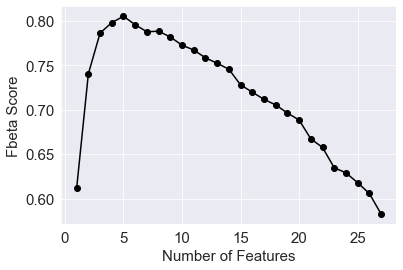

In [131]:
sfs2 = SFS(knn, 
           k_features = 27, 
           forward = True, 
           floating = True, 
           verbose = 2,
           scoring = fO5_scorer,
           cv= CV_time_split)

sfs2 = sfs2.fit(X, y_train, custom_feature_names=list(Feature_Names))
SCORES2=[]
for i in range(1,28):
    SCORES2.append(sfs2.subsets_[i]['avg_score'])
    
plt.plot(list(range(1,28)), SCORES2, '-o', color='black')
plt.xlabel('Number of Features')
plt.ylabel('Fbeta Score')
plt.show()

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  28 out of  28 | elapsed:    4.9s finished

[2022-03-21 06:34:37] Features: 27/2 -- score: 0.5827910143109628[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  27 out of  27 | elapsed:    4.8s finished

[2022-03-21 06:34:42] Features: 26/2 -- score: 0.6057469296189575[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  26 out of  26 | elapsed:    4.2s finished

[2022-03-21 06:34:46] Features: 25/2 -- score: 0.6179144586200028[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done  

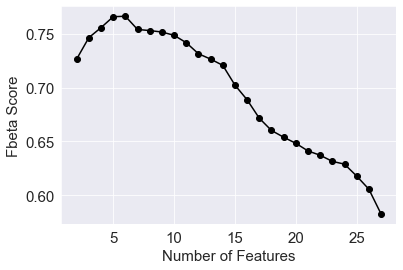

In [132]:
sfs3 = SFS(knn, 
           k_features = 2, 
           forward = False, 
           floating = False, 
           verbose = 2,
           scoring = fO5_scorer,
           cv= CV_time_split)

sfs3 = sfs3.fit(X, y_train, custom_feature_names=list(Feature_Names))
SCORES3=[]
for i in range(2,28):
    SCORES3.append(sfs3.subsets_[i]['avg_score'])
    
plt.plot(list(range(2,28)), SCORES3, '-o', color='black')
plt.xlabel('Number of Features')
plt.ylabel('Fbeta Score')
plt.show()

In [123]:
sfs3.subsets_[3]['avg_score']

0.7463623434858477

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  28 out of  28 | elapsed:    4.7s finished

[2022-03-21 06:35:33] Features: 27/2 -- score: 0.5827910143109628[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  27 out of  27 | elapsed:    4.3s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.1s finished

[2022-03-21 06:35:38] Features: 26/2 -- score: 0.6057469296189575[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jo

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    2.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  13 out of  13 | elapsed:    1.6s finished

[2022-03-21 06:36:40] Features: 14/2 -- score: 0.721040293422214[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  14 out of  14 | elapsed:    1.6s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  14 out of  14 | elapsed:    1.8s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.1s remaining:    0.0s
[Parallel(n

[Parallel(n_jobs=1)]: Done  24 out of  24 | elapsed:    2.8s finished

[2022-03-21 06:37:30] Features: 3/2 -- score: 0.7860422519716014[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  25 out of  25 | elapsed:    2.0s finished

[2022-03-21 06:37:32] Features: 2/2 -- score: 0.7403717338074767

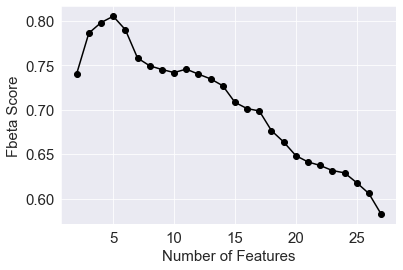

In [133]:
sfs4 = SFS(knn, 
           k_features = 2, 
           forward = False, 
           floating = True, 
           verbose = 2,
           scoring = fO5_scorer,
           cv= CV_time_split)

sfs4 = sfs4.fit(X, y_train, custom_feature_names=list(Feature_Names))
SCORES4=[]
for i in range(2,28):
    SCORES4.append(sfs4.subsets_[i]['avg_score'])
    
plt.plot(list(range(2,28)), SCORES4, '-o', color='black')
plt.xlabel('Number of Features')
plt.ylabel('Fbeta Score')
plt.show()

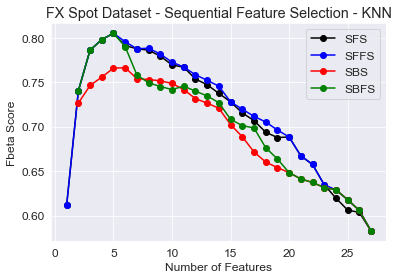

In [500]:
# plot lines
plt.plot(list(range(1,28)), SCORES, '-o', color='black', label='SFS')
plt.plot(list(range(1,28)), SCORES2, '-o', color='blue', label='SFFS')
plt.plot(list(range(2,28)), SCORES3, '-o', color='red', label='SBS')
plt.plot(list(range(2,28)), SCORES4, '-o', color='green', label='SBFS')
plt.legend()
plt.xlabel('Number of Features')
plt.ylabel('Fbeta Score')
plt.title('FX Spot Dataset - Sequential Feature Selection - KNN')
plt.show()

##### SVM as classifier

In [137]:
svm = SVC(kernel='rbf')

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.2s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  28 out of  28 | elapsed:    8.0s finished

[2022-03-21 06:40:11] Features: 1/27 -- score: 0.648770490857414[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  27 out of  27 | elapsed:    5.1s finished

[2022-03-21 06:40:16] Features: 2/27 -- score: 0.7532917613074086[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  26 out of  26 | elapsed:    4.1s finished

[2022-03-21 06:40:21] Features: 3/27 -- score: 0.7650057876687244[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   

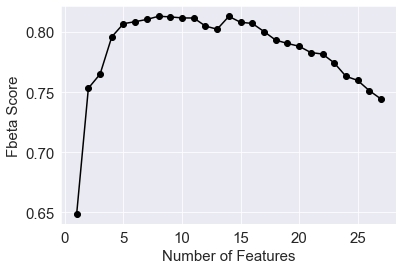

In [138]:
sfs5 = SFS(svm, 
           k_features = 27, 
           forward = True, 
           floating = False, 
           verbose = 2,
           scoring = fO5_scorer,
           cv= CV_time_split)

sfs5 = sfs5.fit(X, y_train, custom_feature_names=list(Feature_Names))
SCORES5=[]
for i in range(1,28):
    SCORES5.append(sfs5.subsets_[i]['avg_score'])
    
plt.plot(list(range(1,28)), SCORES5, '-o', color='black')
plt.xlabel('Number of Features')
plt.ylabel('Fbeta Score')
plt.show()

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.3s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  28 out of  28 | elapsed:    9.9s finished

[2022-03-21 06:41:54] Features: 1/27 -- score: 0.648770490857414[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  27 out of  27 | elapsed:    6.8s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.3s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.3s finished

[2022-03-21 06:42:01] Features: 2/27 -- score: 0.7532917613074086[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_job

[Parallel(n_jobs=1)]: Done  11 out of  11 | elapsed:    2.3s finished

[2022-03-21 06:43:24] Features: 12/27 -- score: 0.8063645747997368[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.2s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  16 out of  16 | elapsed:    3.8s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.2s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  12 out of  12 | elapsed:    2.9s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.2s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  11 out of  11 | elapsed:    2.8s finished

[2022-03-21 06:43:34] Features: 12/27 -- score: 0.8082865505328922[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: 

[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    3.7s finished

[2022-03-21 06:45:10] Features: 16/27 -- score: 0.8071514489815155[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.2s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  12 out of  12 | elapsed:    3.3s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.2s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  16 out of  16 | elapsed:    4.1s finished

[2022-03-21 06:45:17] Features: 17/27 -- score: 0.8004093527585905[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.2s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  11 out of  11 | elapsed:    3.1s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: 

[Parallel(n_jobs=1)]: Done  22 out of  22 | elapsed:    7.8s finished

[2022-03-21 06:47:44] Features: 23/27 -- score: 0.7705455388231962[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.3s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    1.7s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.3s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  23 out of  23 | elapsed:    9.1s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.3s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  22 out of  22 | elapsed:    8.1s finished

[2022-03-21 06:48:03] Features: 23/27 -- score: 0.7746947948513174[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: 

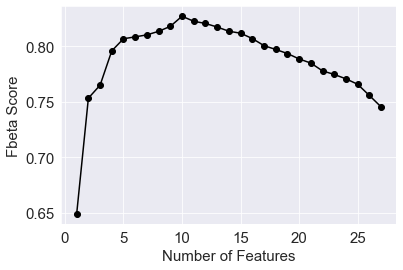

In [139]:
sfs6 = SFS(svm, 
           k_features = 27, 
           forward = True, 
           floating = True, 
           verbose = 2,
           scoring = fO5_scorer,
           cv= CV_time_split)

sfs6 = sfs6.fit(X, y_train, custom_feature_names=list(Feature_Names))
SCORES6=[]
for i in range(1,28):
    SCORES6.append(sfs6.subsets_[i]['avg_score'])
    
plt.plot(list(range(1,28)), SCORES6, '-o', color='black')
plt.xlabel('Number of Features')
plt.ylabel('Fbeta Score')
plt.show()

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.3s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  28 out of  28 | elapsed:   11.7s finished

[2022-03-21 06:48:59] Features: 27/2 -- score: 0.7454632940769527[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.3s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  27 out of  27 | elapsed:   11.3s finished

[2022-03-21 06:49:11] Features: 26/2 -- score: 0.7557635224380351[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.4s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  26 out of  26 | elapsed:   10.6s finished

[2022-03-21 06:49:21] Features: 25/2 -- score: 0.7658349597656605[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done  

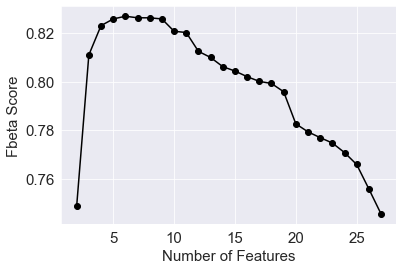

In [140]:
sfs7 = SFS(svm, 
           k_features = 2, 
           forward = False, 
           floating = False, 
           verbose = 2,
           scoring = fO5_scorer,
           cv= CV_time_split)

sfs7 = sfs7.fit(X, y_train, custom_feature_names=list(Feature_Names))
SCORES7=[]
for i in range(2,28):
    SCORES7.append(sfs7.subsets_[i]['avg_score'])
    
plt.plot(list(range(2,28)), SCORES7, '-o', color='black')
plt.xlabel('Number of Features')
plt.ylabel('Fbeta Score')
plt.show()

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.3s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  28 out of  28 | elapsed:   13.0s finished

[2022-03-21 06:51:10] Features: 27/2 -- score: 0.7454632940769527[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.4s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  27 out of  27 | elapsed:   12.4s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.4s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.4s finished

[2022-03-21 06:51:24] Features: 26/2 -- score: 0.7557635224380351[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.3s remaining:    0.0s
[Parallel(n_jo

[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.2s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  14 out of  14 | elapsed:    3.4s finished

[2022-03-21 06:53:40] Features: 13/2 -- score: 0.81689684809726[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.2s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  13 out of  13 | elapsed:    3.1s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.2s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  15 out of  15 | elapsed:    3.8s finished

[2022-03-21 06:53:47] Features: 12/2 -- score: 0.8207237639813455[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.2s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  12 out of  12 | elapsed:    2.9s finished
[Parallel(n_jobs=1)]: Using

ValueError: x and y must have same first dimension, but have shapes (26,) and (0,)

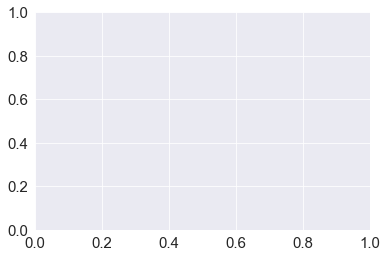

In [141]:
sfs8 = SFS(svm, 
           k_features = 2, 
           forward = False, 
           floating = True, 
           verbose = 2,
           scoring = fO5_scorer,
           cv= CV_time_split)

sfs8 = sfs8.fit(X, y_train, custom_feature_names=list(Feature_Names))
SCORES8=[]
for i in range(2,28):
    SCORES7.append(sfs8.subsets_[i]['avg_score'])
    
plt.plot(list(range(2,28)), SCORES8, '-o', color='black')
plt.xlabel('Number of Features')
plt.ylabel('Fbeta Score')
plt.show()

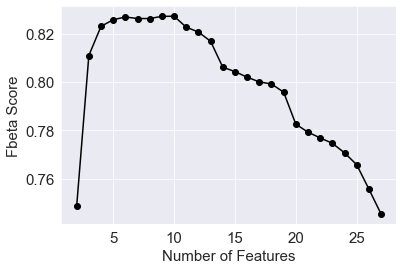

In [150]:
plt.plot(list(range(2,28)), SCORES8, '-o', color='black')
plt.xlabel('Number of Features')
plt.ylabel('Fbeta Score')
plt.show()

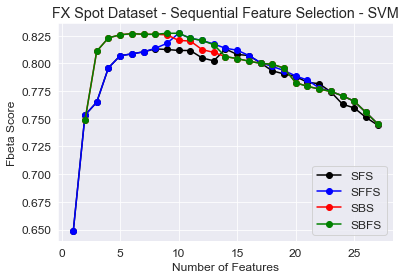

In [501]:
# plot lines
plt.plot(list(range(1,28)), SCORES5, '-o', color='black', label='SFS')
plt.plot(list(range(1,28)), SCORES6, '-o', color='blue', label='SFFS')
plt.plot(list(range(2,28)), SCORES7, '-o', color='red', label='SBS')
plt.plot(list(range(2,28)), SCORES8, '-o', color='green', label='SBFS')
plt.legend()
plt.xlabel('Number of Features')
plt.ylabel('Fbeta Score')
plt.title('FX Spot Dataset - Sequential Feature Selection - SVM')
plt.show()

In [157]:
# SFS picks 8 features for max fbeta score
max_value = max(SCORES5)
max_index = SCORES5.index(max_value)
list(range(1,28))[max_index]

8

In [158]:
# SFFS picks 10 features for max fbeta score
max_value = max(SCORES6)
max_index = SCORES6.index(max_value)
list(range(1,28))[max_index]

10

In [159]:
# SBS picks 6 features for max fbeta score
max_value = max(SCORES7)
max_index = SCORES7.index(max_value)
list(range(2,28))[max_index]

6

In [160]:
# SBFS picks 10 features for max fbeta score
max_value = max(SCORES8)
max_index = SCORES8.index(max_value)
list(range(2,28))[max_index]

10

In [161]:
max_value

0.827252281194994

In [187]:
max(SCORES4)

0.8049915833714852

In [189]:
sfs8.k_feature_idx_

(18, 23)

In [191]:
sfs8.k_feature_names_

('%B ', 'VE_Lower Band')

In [192]:
Feature_Names

Index(['EMAVG (22)', 'EMAVG(5)', 'ROC (5) ', 'ROC (10)', 'Z-Score(260) ',
       'Z-Score(130) ', 'Z-Score(65) ', 'RSI (22) ', 'Spearman Indicator(22)',
       'MACD(11,22)', '%DS(5)', '%DSS(3)', 'Coppock(21,5,10) ',
       'Fisher Transform(5)', 'UBB(2)', 'BollMA (22)', 'LBB(2)',
       'BollW (EURUSD BGN)', '%B ', 'MLR(10,0,0)', 'MLRUB(1)', 'MLRLB(1)',
       'VE_Upper Band', 'VE_Lower Band', ''+DMI(10)', ''-DMI', 'ADX',
       'RMI(Close,21,10)'],
      dtype='object')

# GET FEATURE NAMES OF BEST FEATURES FOR ALL FOUR AND DO MAYBE FREQUENCY CHART TO SEE WHICH FEATURES TO INCLUDE

In [181]:
def Best_Features(Clf, K, Forward_Flag, Floating_Flag):
    sfs = SFS(Clf, 
               k_features = K, 
               forward = Forward_Flag, 
               floating = Floating_Flag, 
               verbose = False,
               scoring = fO5_scorer,
               cv= CV_time_split)

    sfs = sfs.fit(X, y_train, custom_feature_names=list(Feature_Names))
    return (sfs.k_feature_names_, sfs.k_score_)

In [172]:
#SFS KNN
Best_Features(knn, 5, True, False)

(('ROC (5) ', 'BollW (EURUSD BGN)', '%B ', 'VE_Upper Band', 'VE_Lower Band'),
 0.8049915833714852)

In [173]:
#SFFS KNN
Best_Features(knn, 5, True, True)

(('ROC (5) ', 'BollW (EURUSD BGN)', '%B ', 'VE_Upper Band', 'VE_Lower Band'),
 0.8049915833714852)

In [174]:
#SBS KNN
Best_Features(knn, 5, False, False)

(('EMAVG (22)', 'ROC (5) ', 'ROC (10)', 'VE_Upper Band', 'VE_Lower Band'),
 0.7657794024984396)

In [175]:
#SBFS KNN
Best_Features(knn, 5, False, True)

(('ROC (5) ', 'BollW (EURUSD BGN)', '%B ', 'VE_Upper Band', 'VE_Lower Band'),
 0.8049915833714852)

In [182]:
#SFS SVM
Best_Features(svm, 10, True, False)

(('EMAVG (22)',
  'EMAVG(5)',
  'ROC (5) ',
  'ROC (10)',
  'Coppock(21,5,10) ',
  'UBB(2)',
  'MLR(10,0,0)',
  'MLRLB(1)',
  'VE_Upper Band',
  'VE_Lower Band'),
 0.8117168266869385)

In [183]:
#SFFS SVM
Best_Features(svm, 10, True, True)

(('EMAVG(5)',
  'ROC (5) ',
  'ROC (10)',
  'Coppock(21,5,10) ',
  'BollMA (22)',
  'MLR(10,0,0)',
  'MLRUB(1)',
  'MLRLB(1)',
  'VE_Upper Band',
  'VE_Lower Band'),
 0.8175744858062807)

In [184]:
#SBS SVM
Best_Features(svm, 10, False, False)

(('EMAVG(5)',
  'ROC (5) ',
  'BollMA (22)',
  'BollW (EURUSD BGN)',
  '%B ',
  'MLR(10,0,0)',
  'MLRUB(1)',
  'MLRLB(1)',
  'VE_Upper Band',
  'VE_Lower Band'),
 0.8207600840118248)

In [185]:
#SBS SVM
Best_Features(svm, 10, False, True)

(('EMAVG(5)',
  'ROC (10)',
  'UBB(2)',
  'BollMA (22)',
  'BollW (EURUSD BGN)',
  '%B ',
  'MLR(10,0,0)',
  'MLRLB(1)',
  'VE_Upper Band',
  'VE_Lower Band'),
 0.827252281194994)

In [232]:
Feature_Names

Index(['EMAVG (22)', 'EMAVG(5)', 'ROC (5) ', 'ROC (10)', 'Z-Score(260) ',
       'Z-Score(130) ', 'Z-Score(65) ', 'RSI (22) ', 'Spearman Indicator(22)',
       'MACD(11,22)', '%DS(5)', '%DSS(3)', 'Coppock(21,5,10) ',
       'Fisher Transform(5)', 'UBB(2)', 'BollMA (22)', 'LBB(2)',
       'BollW (EURUSD BGN)', '%B ', 'MLR(10,0,0)', 'MLRUB(1)', 'MLRLB(1)',
       'VE_Upper Band', 'VE_Lower Band', ''+DMI(10)', ''-DMI', 'ADX',
       'RMI(Close,21,10)'],
      dtype='object')

In [249]:
#BEST 5 Features KNN
KNN_Features = [Feature_Names[i] for i in [2,17,18,22,23]]
KNN_Features

['ROC (5) ', 'BollW (EURUSD BGN)', '%B ', 'VE_Upper Band', 'VE_Lower Band']

In [234]:
#New Reduced X with BEST 5 Features KNN
New_X_KNN = X[:, np.r_[2,17,18,22,23]]

In [530]:
#BEST 10 Features SVM
SVM_Features = [Feature_Names[i] for i in [1,3,14,15,17,18,19,21,22,23]]
SVM_Features

['EMAVG(5)',
 'ROC (10)',
 'UBB(2)',
 'BollMA (22)',
 'BollW (EURUSD BGN)',
 '%B ',
 'MLR(10,0,0)',
 'MLRLB(1)',
 'VE_Upper Band',
 'VE_Lower Band']

In [221]:
#New Reduced X with BEST 10 Features SVM
New_X_SVM = X[:, np.r_[1,3,14,15,17,18,19,21,22,23]]

#### Feeding Optimal Features to Kmeans FS KNN

In [521]:
ks = range(2, 11)
inertias = []
sse, db, slc = {}, {}, {}
for k in ks:
    # Create a KMeans instance with k clusters: model
    model = KMeans(n_clusters=k)
    
    # Fit model to samples
    #We are using 12 Independent components, because with n=12 we maximize the avg kurtosis
    FIT = model.fit(New_X_KNN)
    
    # Append the inertia to the list of inertias
    inertias.append(model.inertia_)
    
    clusters = FIT.labels_
    sse[k] = FIT.inertia_
    db[k] = davies_bouldin_score(New_X_KNN, clusters)
    slc[k] = silhouette_score(New_X_KNN, clusters)
    

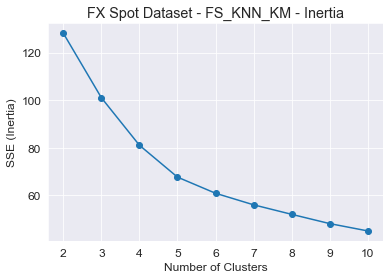

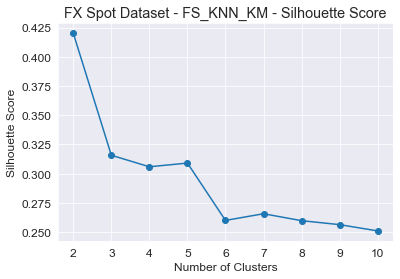

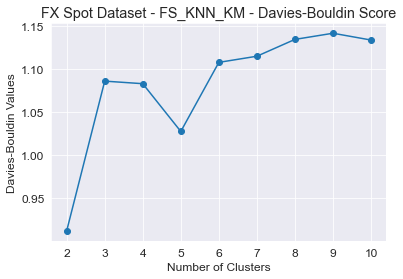

In [523]:
### Elbow Method

sns.set_style("darkgrid")
plt.plot(list(sse.keys()), list(sse.values()), marker='o')
plt.xlabel('Number of Clusters')
plt.ylabel('SSE (Inertia)')
plt.title('FX Spot Dataset - FS_KNN_KM - Inertia')
plt.show()
# 4 Seems to be the best k value according to Elbow method

### Silhouette Analysis

plt.plot(list(slc.keys()), list(slc.values()), marker='o')
plt.xlabel('Number of Clusters')
plt.ylabel('Silhouette Score')
plt.title('FX Spot Dataset - FS_KNN_KM - Silhouette Score')
plt.show()
#For Sillhouette Score the higher the better. It seems like 2 is the best k accoring to sillhouette

### Davies-Bouldin Index

plt.plot(list(db.keys()), list(db.values()), marker='o')
plt.xlabel('Number of Clusters')
plt.ylabel('Davies-Bouldin Values')
plt.title('FX Spot Dataset - FS_KNN_KM - Davies-Bouldin Score')
plt.show()
# For DB Index the lower the better so k=2 seems to be the best value here.

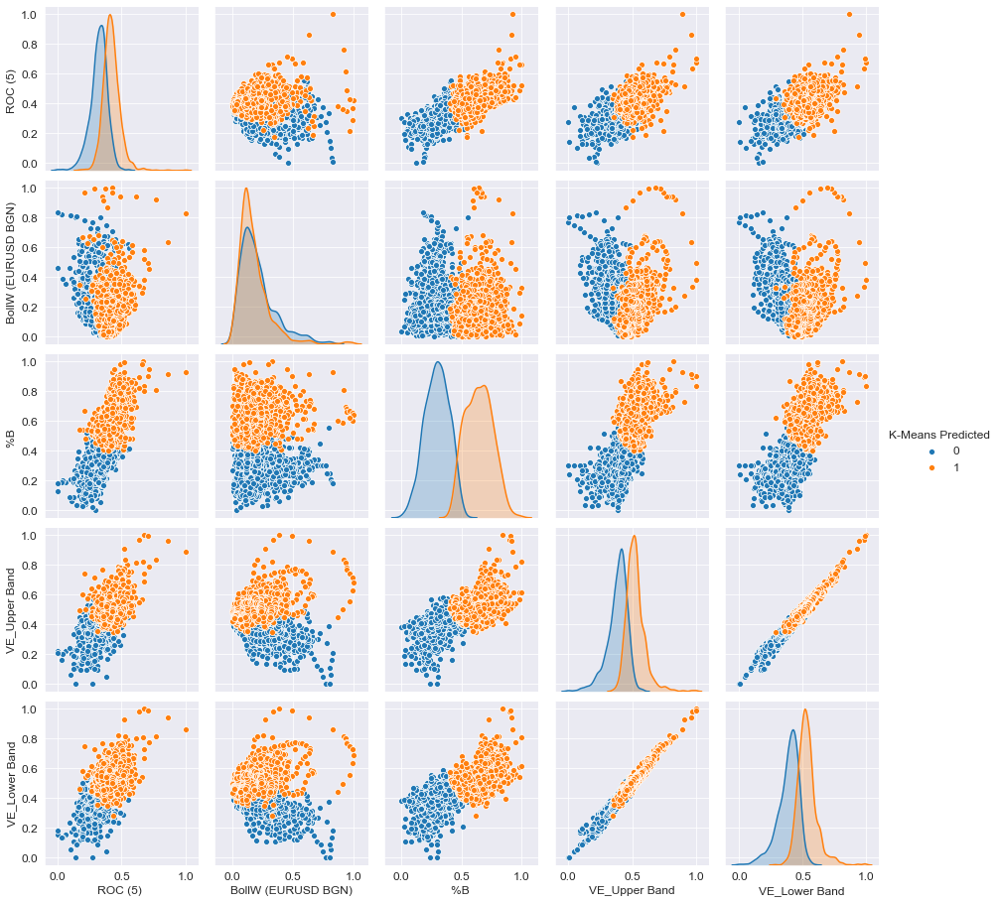

In [524]:
#Visualize Cluster distribution based on FS
#Print out diagonal labels based on K= optimal k
FIVE_FEATURES_KNN = pd.DataFrame(New_X_KNN, columns= KNN_Features)
kmeans = KMeans(n_clusters = 2, init = 'k-means++',random_state=1).fit(New_X_KNN)
clusters_FS_KNN = kmeans.labels_
FIVE_FEATURES_KNN['K-Means Predicted'] = clusters_FS_KNN
sns.pairplot(FIVE_FEATURES_KNN, hue="K-Means Predicted", diag_kind= 'kde')

In [525]:
FIVE_FEATURES_KNN['Truth'] = y_train

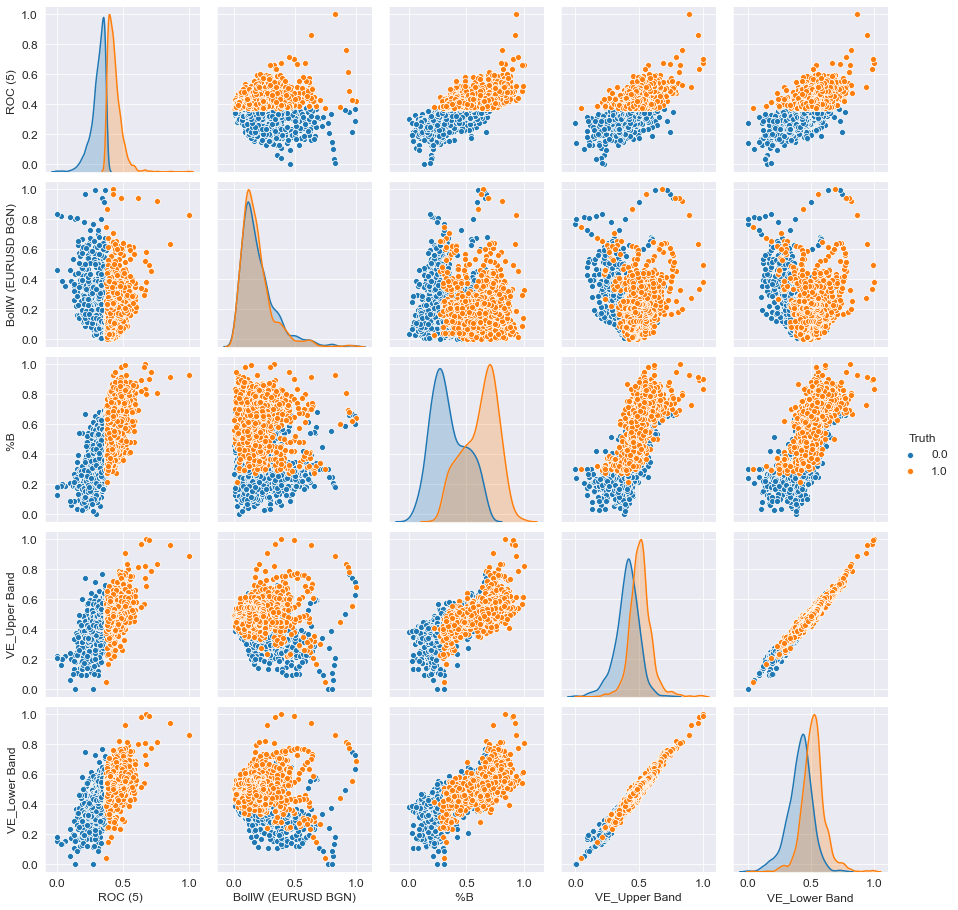

In [526]:
sns.pairplot(FIVE_FEATURES_KNN.iloc[:, np.r_[:5,-1]], hue="Truth", diag_kind= 'kde') 

In [527]:
#Cluster Performance Scores FS_KNN_KM
print(v_measure_score(y_train,clusters_FS_KNN))
print(homogeneity_score(y_train,clusters_FS_KNN))
print(completeness_score(y_train,clusters_FS_KNN))
print(adjusted_rand_score(y_train,clusters_FS_KNN))
print(fowlkes_mallows_score(y_train,clusters_FS_KNN))

0.006535612157560234
0.006526087386659432
0.006545164771747768
0.008583588248264626
0.5051175902791987


##### Feeding Optimal Features to Kmeans SVM

In [528]:
ks = range(2, 21)
inertias = []
sse, db, slc = {}, {}, {}
for k in ks:
    # Create a KMeans instance with k clusters: model
    model = KMeans(n_clusters=k)
    
    # Fit model to samples
    #We are using 12 Independent components, because with n=12 we maximize the avg kurtosis
    FIT = model.fit(New_X_SVM)
    
    # Append the inertia to the list of inertias
    inertias.append(model.inertia_)
    
    clusters = FIT.labels_
    sse[k] = FIT.inertia_
    db[k] = davies_bouldin_score(New_X_SVM, clusters)
    slc[k] = silhouette_score(New_X_SVM, clusters)
    
#Elbow (lowest inertia) is 20

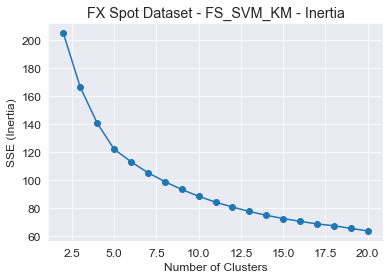

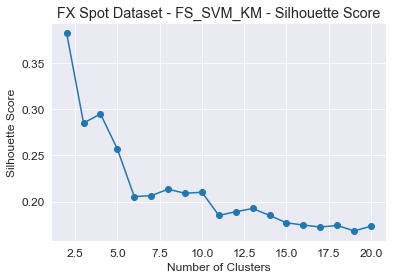

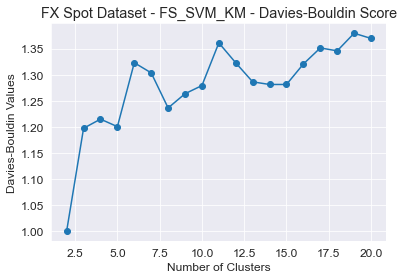

In [529]:
### Elbow Method

sns.set_style("darkgrid")
plt.plot(list(sse.keys()), list(sse.values()), marker='o')
plt.xlabel('Number of Clusters')
plt.ylabel('SSE (Inertia)')
plt.title('FX Spot Dataset - FS_SVM_KM - Inertia')
plt.show()
# 4 Seems to be the best k value according to Elbow method

### Silhouette Analysis

plt.plot(list(slc.keys()), list(slc.values()), marker='o')
plt.xlabel('Number of Clusters')
plt.ylabel('Silhouette Score')
plt.title('FX Spot Dataset - FS_SVM_KM - Silhouette Score')
plt.show()
#For Sillhouette Score the higher the better. It seems like 2 is the best k accoring to sillhouette

### Davies-Bouldin Index

plt.plot(list(db.keys()), list(db.values()), marker='o')
plt.xlabel('Number of Clusters')
plt.ylabel('Davies-Bouldin Values')
plt.title('FX Spot Dataset - FS_SVM_KM - Davies-Bouldin Score')
plt.show()
# For DB Index the lower the better so k=2 seems to be the best value here.

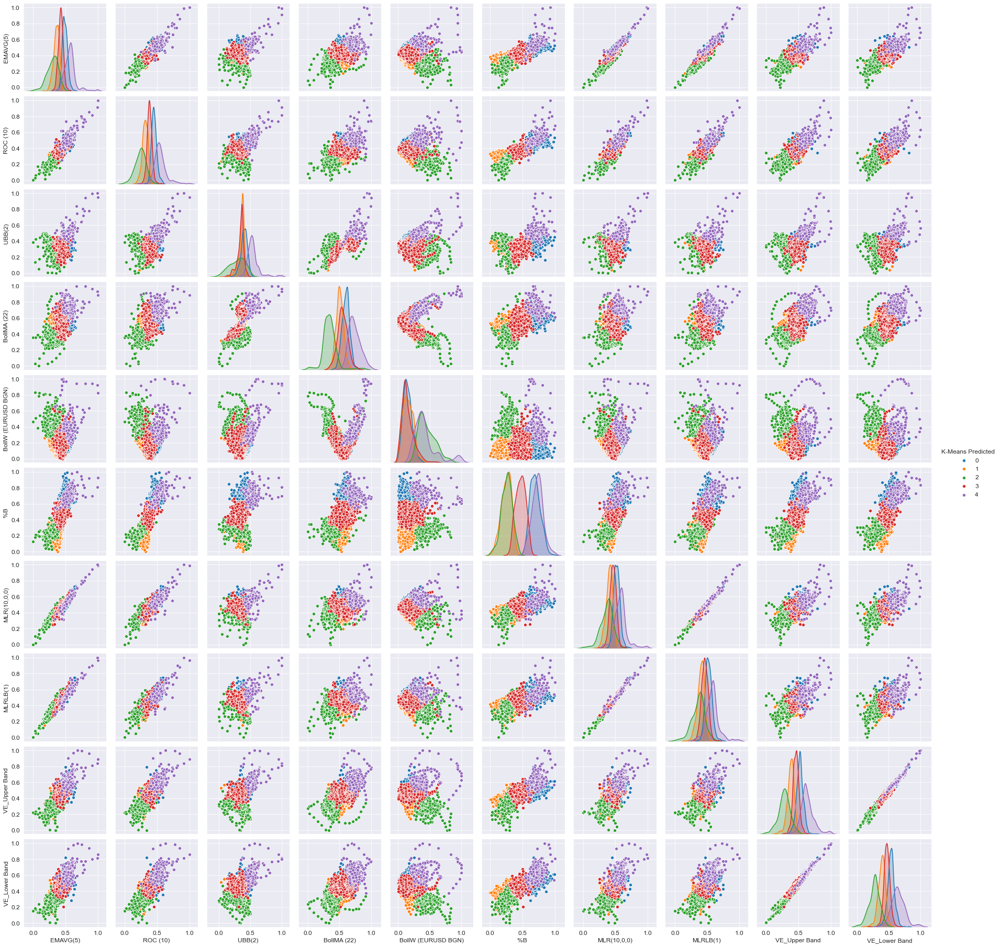

In [532]:
#Visualize Cluster distribution based on RP
#Print out diagonal labels based on K= optimal k = 5
TEN_FEATURES_SVM = pd.DataFrame(New_X_SVM, columns=SVM_Features)
kmeans = KMeans(n_clusters = 5, init = 'k-means++',random_state=1).fit(New_X_SVM)
clusters_FS_SVM = kmeans.labels_
TEN_FEATURES_SVM['K-Means Predicted'] = clusters_FS_SVM
sns.pairplot(TEN_FEATURES_SVM, hue="K-Means Predicted", diag_kind= 'kde')

In [533]:
TEN_FEATURES_SVM['Truth'] = y_train

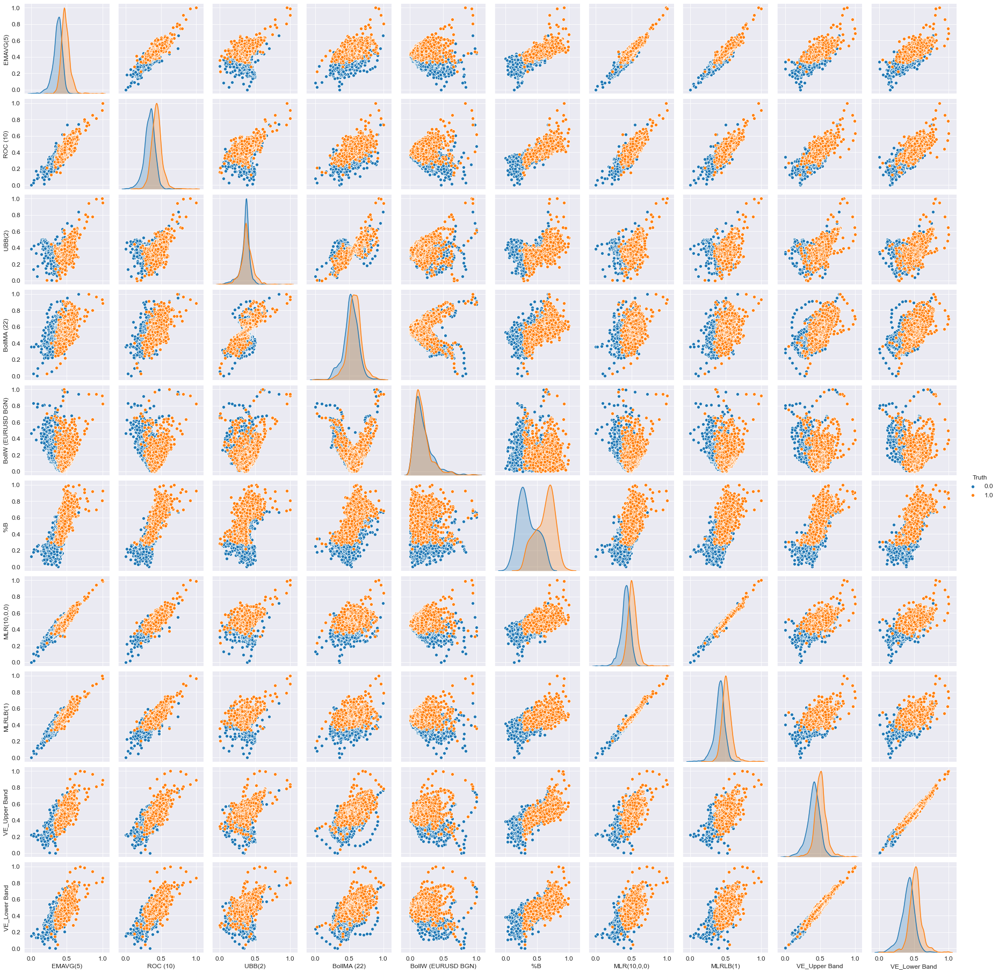

In [534]:
sns.pairplot(TEN_FEATURES_SVM.iloc[:, np.r_[:10,-1]], hue="Truth", diag_kind= 'kde') 

In [535]:
#Cluster Performance Scores FS SVM
print(v_measure_score(y_train,clusters_FS_SVM))
print(homogeneity_score(y_train,clusters_FS_SVM))
print(completeness_score(y_train,clusters_FS_SVM))
print(adjusted_rand_score(y_train,clusters_FS_SVM))
print(fowlkes_mallows_score(y_train,clusters_FS_SVM))

0.008767894520087199
0.013523826925168993
0.00648670947169249
0.006133583825270212
0.3626721074160069


#### EM Clustering with KNN FS

In [536]:
#Silhouette coefficient
n_clusters=np.arange(2, 16)
sils=[]
sils_err=[]
iterations=20
for n in n_clusters:
    tmp_sil=[]
    for _ in range(iterations):
        gmm=GaussianMixture(n, n_init=2).fit(New_X_KNN) 
        labels=gmm.predict(New_X_KNN)
        sil=metrics.silhouette_score(New_X_KNN, labels, metric='euclidean')
        tmp_sil.append(sil)
    val=np.mean(SelBest(np.array(tmp_sil), int(iterations/5)))
    err=np.std(tmp_sil)
    sils.append(val)
    sils_err.append(err)

Text(0, 0.5, 'Silhouette Score')

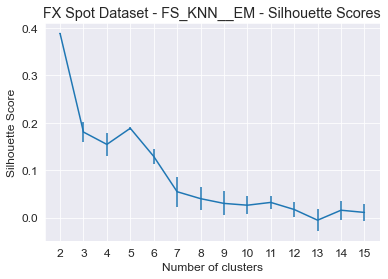

In [537]:
plt.errorbar(n_clusters, sils, yerr=sils_err)
plt.title("FX Spot Dataset - FS_KNN__EM - Silhouette Scores")
plt.xticks(n_clusters)
plt.xlabel("Number of clusters")
plt.ylabel("Silhouette Score")

In [538]:
#Distance between train and test GMMs
n_clusters=np.arange(2, 16)
iterations=20
results=[]
res_sigs=[]
for n in n_clusters:
    dist=[]
    
    for iteration in range(iterations):
        train, test=train_test_split(New_X_KNN, test_size=0.5)
        
        gmm_train=GaussianMixture(n, n_init=2).fit(train) 
        gmm_test=GaussianMixture(n, n_init=2).fit(test) 
        dist.append(gmm_js(gmm_train, gmm_test))
    selec=SelBest(np.array(dist), int(iterations/5))
    result=np.mean(selec)
    res_sig=np.std(selec)
    results.append(result)
    res_sigs.append(res_sig)

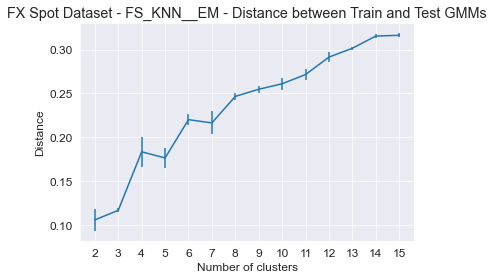

In [539]:
plt.errorbar(n_clusters, results, yerr=res_sigs)
plt.title("FX Spot Dataset - FS_KNN_EM - Distance between Train and Test GMMs")
plt.xticks(n_clusters)
plt.xlabel("Number of clusters")
plt.ylabel("Distance")
plt.show()

In [541]:
# BIC
n_clusters=np.arange(2, 16)
bics=[]
bics_err=[]
iterations=20
for n in n_clusters:
    tmp_bic=[]
    for _ in range(iterations):
        gmm=GaussianMixture(n, n_init=2).fit(New_X_KNN) 
        
        tmp_bic.append(gmm.bic(New_X_KNN))
    val=np.mean(SelBest(np.array(tmp_bic), int(iterations/5)))
    err=np.std(tmp_bic)
    bics.append(val)
    bics_err.append(err)

Text(0, 0.5, 'BIC Score')

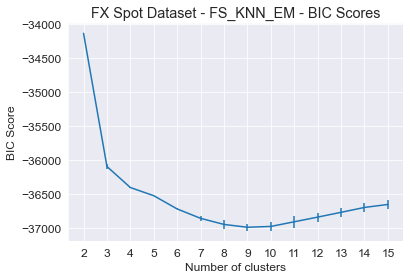

In [542]:
plt.errorbar(n_clusters,bics, yerr=bics_err, label='BIC')
plt.title("FX Spot Dataset - FS_KNN_EM - BIC Scores")
plt.xticks(n_clusters)
plt.xlabel("Number of clusters")
plt.ylabel("BIC Score")

In [543]:
#Lets create our EM with our 5 KNN features and 5 Clusters
KNN_EM =GaussianMixture(5, n_init=2).fit(New_X_KNN) #Fit our EM model with 2 clusters, feeding the Indep Components as our X
clusters_KNN_EM = KNN_EM.predict(New_X_KNN) # generate cluster assignmant based on our data and the two clusters
clusters_KNN_EM_prob = KNN_EM.predict_proba(New_X_KNN) #generate probability of cluster assignmnet

In [544]:
#Idea is to find the max prob of each row and average them. A value close to 1 will mean that the clustering is good because
# the algorithm is quite confident that a datapoint will belong to a specific cluster. On the other hand, an average prob
# value of 0.5 is quite poor because it means the algo is only slightly better than chance in terms of its confidence.

# axis=1 to find max from each row
np.amax(clusters_KNN_EM_prob, axis=1).mean()
#This is a GOOD value! :) Now lets look at the cluster PMs

0.857504473993564

In [545]:
#Cluster Performance Scores FS KNN EM
print(v_measure_score(y_train,clusters_KNN_EM))
print(homogeneity_score(y_train,clusters_KNN_EM))
print(completeness_score(y_train,clusters_KNN_EM))
print(adjusted_rand_score(y_train,clusters_KNN_EM))
print(fowlkes_mallows_score(y_train,clusters_KNN_EM))

0.005086364227797742
0.008152102171260604
0.003696305210379119
0.004136545823674365
0.34283331879225476


#### EM Clustering with SVM FS

In [546]:
#Silhouette coefficient
n_clusters=np.arange(2, 16)
sils=[]
sils_err=[]
iterations=20
for n in n_clusters:
    tmp_sil=[]
    for _ in range(iterations):
        gmm=GaussianMixture(n, n_init=2).fit(New_X_SVM) 
        labels=gmm.predict(New_X_SVM)
        sil=metrics.silhouette_score(New_X_SVM, labels, metric='euclidean')
        tmp_sil.append(sil)
    val=np.mean(SelBest(np.array(tmp_sil), int(iterations/5)))
    err=np.std(tmp_sil)
    sils.append(val)
    sils_err.append(err)

Text(0, 0.5, 'Silhouette Score')

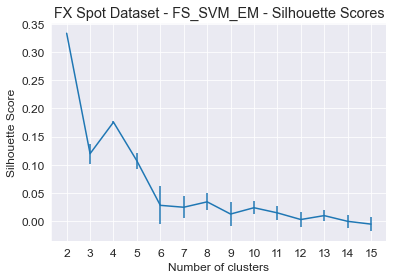

In [547]:
plt.errorbar(n_clusters, sils, yerr=sils_err)
plt.title("FX Spot Dataset - FS_SVM_EM - Silhouette Scores")
plt.xticks(n_clusters)
plt.xlabel("Number of clusters")
plt.ylabel("Silhouette Score")

In [548]:
#Distance between train and test GMMs
n_clusters=np.arange(2, 16)
iterations=20
results=[]
res_sigs=[]
for n in n_clusters:
    dist=[]
    
    for iteration in range(iterations):
        train, test=train_test_split(New_X_SVM, test_size=0.5)
        
        gmm_train=GaussianMixture(n, n_init=2).fit(train) 
        gmm_test=GaussianMixture(n, n_init=2).fit(test) 
        dist.append(gmm_js(gmm_train, gmm_test))
    selec=SelBest(np.array(dist), int(iterations/5))
    result=np.mean(selec)
    res_sig=np.std(selec)
    results.append(result)
    res_sigs.append(res_sig)

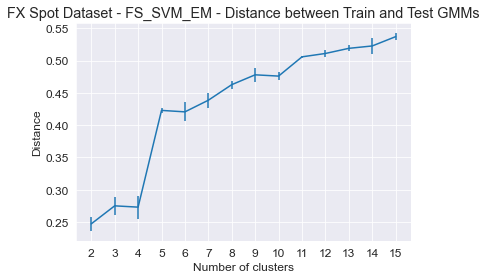

In [549]:
plt.errorbar(n_clusters, results, yerr=res_sigs)
plt.title("FX Spot Dataset - FS_SVM_EM - Distance between Train and Test GMMs")
plt.xticks(n_clusters)
plt.xlabel("Number of clusters")
plt.ylabel("Distance")
plt.show()

In [550]:
# BIC
n_clusters=np.arange(2, 16)
bics=[]
bics_err=[]
iterations=20
for n in n_clusters:
    tmp_bic=[]
    for _ in range(iterations):
        gmm=GaussianMixture(n, n_init=2).fit(New_X_SVM) 
        
        tmp_bic.append(gmm.bic(New_X_SVM))
    val=np.mean(SelBest(np.array(tmp_bic), int(iterations/5)))
    err=np.std(tmp_bic)
    bics.append(val)
    bics_err.append(err)

Text(0, 0.5, 'BIC Score')

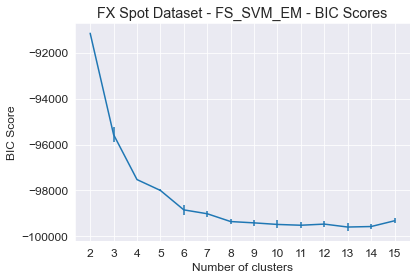

In [551]:
plt.errorbar(n_clusters,bics, yerr=bics_err, label='BIC')
plt.title("FX Spot Dataset - FS_SVM_EM - BIC Scores")
plt.xticks(n_clusters)
plt.xlabel("Number of clusters")
plt.ylabel("BIC Score")

In [552]:
#Lets create our EM with our 10 SVM features and 4 Clusters
SVM_EM =GaussianMixture(4, n_init=2).fit(New_X_SVM) #Fit our EM model with 2 clusters, feeding the Indep Components as our X
clusters_SVM_EM = SVM_EM.predict(New_X_SVM) # generate cluster assignmant based on our data and the two clusters
clusters_SVM_EM_prob = SVM_EM.predict_proba(New_X_SVM) #generate probability of cluster assignmnet

In [553]:
#Idea is to find the max prob of each row and average them. A value close to 1 will mean that the clustering is good because
# the algorithm is quite confident that a datapoint will belong to a specific cluster. On the other hand, an average prob
# value of 0.5 is quite poor because it means the algo is only slightly better than chance in terms of its confidence.

# axis=1 to find max from each row
np.amax(clusters_SVM_EM_prob, axis=1).mean()
#This is a GOOD value! :) Now lets look at the cluster PMs

0.9385240838116561

In [554]:
#Cluster Performance Scores FS SVM EM
print(v_measure_score(y_train,clusters_SVM_EM))
print(homogeneity_score(y_train,clusters_SVM_EM))
print(completeness_score(y_train,clusters_SVM_EM))
print(adjusted_rand_score(y_train,clusters_SVM_EM))
print(fowlkes_mallows_score(y_train,clusters_SVM_EM))

0.00025045531103238557
0.00036151436794781925
0.0001915960329196411
-0.0002988529755007485
0.37967707710588366


# END